# Preamble

In [1]:
import Pkg;
Pkg.add("ForwardDiff"); 
Pkg.add("Plots"); 
Pkg.add("LaTeXStrings"); 
Pkg.add("DifferentialEquations"); 
Pkg.add("Roots"); 
Pkg.add("QuadGK"); 
Pkg.add("HCubature");
Pkg.add("MultiQuad");
Pkg.add("Interpolations");
Pkg.add("Dierckx");
Pkg.add("SpecialFunctions");
Pkg.add("LinearAlgebra");
Pkg.add("DelimitedFiles");

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
   Resolving package version

In [7]:
using ForwardDiff, Plots, LaTeXStrings, DifferentialEquations, Roots, QuadGK, HCubature, MultiQuad, Interpolations, Dierckx, SpecialFunctions, LinearAlgebra, DelimitedFiles
default(framestyle=:box, guidefont=font(14), titlefont=font(14), tickfont=font(12), legend_font=font(12), legend=false, linewidth=3, linestyle=:auto);

In [8]:
Mpl = 2.435e18; # reduced Planck mass in GeV
c = 299792458; # speed of light in m/s
KinGeV = (1.160e4)^-1 * 10^-9; # Kelvin in GeV
Mpcinm = 3.086e16 * 10^6; # Mpc in m
GeVinminv = 10^9/(1.973e-7); # GeV in m^-1
GeVinMpcinv = GeVinminv * Mpcinm; # GeV in Mpc^-1
MpcinvinHz = c/Mpcinm; # Mpc^inv in Hz
yrins = 365.2422 * 24 * 60 * 60; # yr in s

Or0h2 = 4.2e-5; # current radiation density parameter * h^2
Hubblh = 0.674; # normalised Hubble parameter h

T0 = 2.725*KinGeV; # current temperature
grho0 = 3.383; # current grho
gs0 = 3.931; # current gs

In [9]:
Threads.nthreads()

10

# Background

## calculation

In [7]:
ai = [1, 1.11724, 3.12672e-1, -4.68049e-2, -2.65004e-2, -1.19760e-3, 1.82812e-4, 1.36436e-4, 8.55051e-5, 1.22840e-5, 3.82259e-7, -6.87035e-9];
bi = [1.43382e-2, 1.37559e-2, 2.92108e-3, -5.38533e-4, -1.62496e-4, -2.87906e-5, -3.84278e-6, 2.78776e-6, 7.40342e-7, 1.17210e-7, 3.72499e-9, -6.74107e-11];
ci = [1, 6.07869e-1, -1.54485e-1, -2.24034e-1, -2.82147e-2, 2.90620e-2, 6.86778e-3, -1.00005e-3, -1.69104e-4, 1.06301e-5, 1.69528e-6, -9.33311e-8];
di = [7.07388e1, 9.18011e1, 3.31892e1, -1.39779, -1.52558, -1.97857e-2, -1.60146e-1, 8.22615e-5, 2.02651e-2, -1.82134e-5, 7.83943e-5, 7.13518e-5];

In [9]:
Tth = 0.12; # temperature separation in GeV

In [11]:
grhohigh(T) = sum([ai[i]*log(T)^(i - 1) for i=1:12]) / sum([bi[i]*log(T)^(i - 1) for i=1:12]); # eff. DoF for energy density for T > 0.12 GeV
gshigh(T) = grhohigh(T) / (1 + sum([ci[i]*log(T)^(i - 1) for i=1:12]) / sum([di[i]*log(T)^(i - 1) for i=1:12])); # eff. DoF for entropy for T > 0.12 GeV

In [13]:
rhohigh(T) = π^2/30*grhohigh(T)*T^4; # energy density for T > 0.12 GeV
shigh(T) = 2*π^2/45*gshigh(T)*T^3; # entropy for T > 0.12 GeV
phigh(T) = T*shigh(T) - rhohigh(T); # pressure for T > 0.12 GeV

In [15]:
# some fitting functions
Sfit(x) = 1 + 7/4*exp(-1.0419*x) * (1 + 1.034*x + 0.456426*x^2 + 0.0595249*x^3);
frho(x) = exp(-1.04855*x) * (1 + 1.03757*x + 0.508630*x^2 + 0.0893988*x^3);
brho(x) = exp(-1.03149*x) * (1 + 1.03317*x + 0.398264*x^2 + 0.0648056*x^3);
fs(x) = exp(-1.04190*x) * (1 + 1.03400*x + 0.456426*x^2 + 0.0595248*x^3);
bs(x) = exp(-1.03365*x) * (1 + 1.03397*x + 0.342548*x^2 + 0.0506182*x^3);

In [17]:
# mass params. in GeV
me = 511e-6;
mmu = 0.1056;
mpi0 = 0.13;
mpipm = 0.140;
m1 = 0.5;
m2 = 0.77;
m3 = 1.2;
m4 = 2;

In [19]:
# neutrino temperature
Tnu(T) = (4/11)^(1/3) * Sfit(me/T)^(1/3) * T;

In [21]:
grhogammalow(T) = 2.030 + 3.495*frho(me/T) + 3.446*frho(mmu/T) + 1.05*brho(mpi0/T) + 2.08*brho(mpipm/T) + 4.165*brho(m1/T) + 30.55*brho(m2/T) + 89.4*brho(m3/T) + 8209*brho(m4/T); # eff. DoF for photon energy density for T < 0.12 GeV
gsgammalow(T) = 2.008 + 3.442*fs(me/T) + 3.468*fs(mmu/T) + 1.034*bs(mpi0/T) + 2.068*bs(mpipm/T) + 4.16*bs(m1/T) + 30.55*bs(m2/T) + 90*bs(m3/T) + 6209*bs(m4/T); # eff. DoF for photon entropy for T < 0.12 GeV
grhonulow(T) = 1.353*Sfit(me/T)^(4/3); # eff. DoF for neutrino energy density for T < 0.12 GeV
gsnulow(T) = 1.923*Sfit(me/T); # eff. DoF for neutrino entropy for T < 0.12 GeV

In [23]:
# T < 0.12 GeV
rhogammalow(T) = π^2/30*grhogammalow(T)*T^4; # photon energy density
sgammalow(T) = 2*π^2/45*gsgammalow(T)*T^3; # photon entropy
rhonulow(T) = π^2/30*grhonulow(T)*T^4; # neutrino energy density
snulow(T) = 2*π^2/45*gsnulow(T)*T^3; # neutrino entropy
pgammalow(T) = T*sgammalow(T) - rhogammalow(T); # photon pressure
pnulow(T) = Tnu(T)*snulow(T) - rhonulow(T); # neutrino pressure
rholow(T) = rhogammalow(T) + rhonulow(T); # total energy density
plow(T) = pgammalow(T) + pnulow(T); # total pressure

In [25]:
function grho(T) # eff. DoF for energy density
    if T >= Tth
        return grhohigh(T)
    else
        return grhogammalow(T) + grhonulow(T)
    end
end;

function grhop(T) # T-derivative of grho
    if T >= Tth
        return ForwardDiff.derivative(grhohigh,T)
    else
        return ForwardDiff.derivative(grhogammalow,T) + ForwardDiff.derivative(grhonulow,T)
    end
end;

function gs(T) # eff. DoF for entropy
    if T >= Tth
        return gshigh(T)
    else
        return gsgammalow(T) + gsnulow(T)
    end
end;

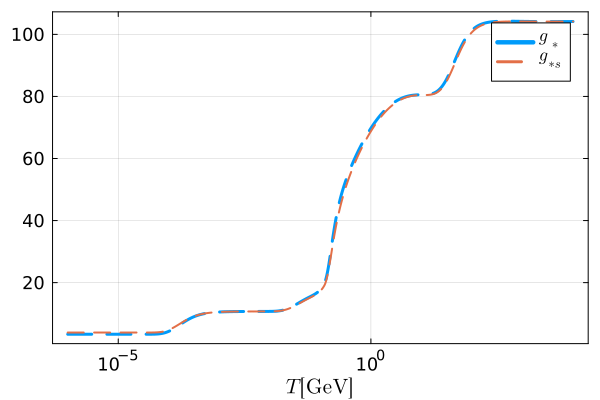

In [27]:
Tlist = [10^i for i=-6:0.01:4]
plot(grho, Tlist, xscale=:log10, label=L"$g_*$", xlabel=L"$T\,[\mathrm{GeV}]$", legend=true)
plot!(gs, Tlist, label=L"$g_{*s}$", linestyle=:dash, linewidth=:2)

In [28]:
function rho(T) # energy density
    if T >= Tth
        return rhohigh(T)
    else 
        return rholow(T)
    end
end;

function press(T) # pressure
    if T >= Tth
        return phigh(T)
    else
        return plow(T)
    end
end;

In [29]:
EoSw(T) = press(T)/rho(T); # equation-of-state param. w

function cs2(T) # sound speed squared
    if T >= Tth
        return ForwardDiff.derivative(phigh,T)/ForwardDiff.derivative(rhohigh,T)
    else
        return ForwardDiff.derivative(plow,T)/ForwardDiff.derivative(rholow,T)
    end
end;

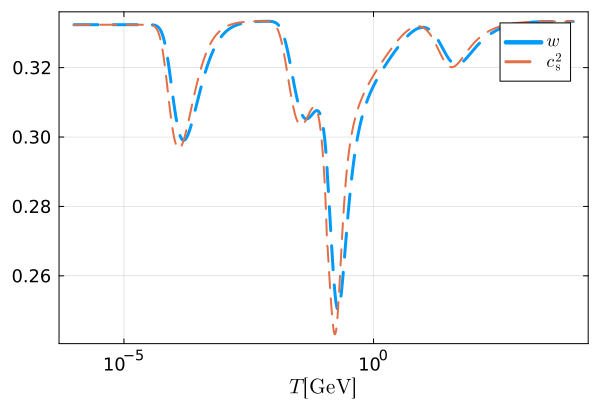

In [30]:
plot(EoSw, Tlist, xscale=:log10, label=L"$w$", xlabel=L"$T\,[\mathrm{GeV}]$", legend=true)
plot!(cs2, Tlist, label=L"$c_\mathrm{s}^2$", linestyle=:dash, linewidth=:2)

In [31]:
T0 = 2.725*KinGeV; # current temperature
grho0 = grho(T0); # current grho
gs0 = gs(T0); # current gs

In [32]:
calH(T, scalea) = scalea * sqrt(rho(T)/3/Mpl^2) * GeVinMpcinv; # conformal Hubble in Mpc^-1

In [36]:
Ti = 1e6; # initial temperature
scaleai = (gs0/gs(Ti))^(1/3)*T0/Ti; # temporal initial scale factor 
etai = 1/calH(Ti, scaleai); # initial conformal time

etaf = 10; # final conformal time

In [37]:
etai

5.842207902333349e-14

In [43]:
function bgEoM(du,u,p,lneta) # u[1] = T, u[2] = scalea
    du[1] = -3*exp(lneta)*(1 + EoSw(u[1])) * calH(u[1], u[2]) * grho(u[1]) / (grhop(u[1]) + 4*grho(u[1])/u[1])
    du[2] = exp(lneta)*u[2]*calH(u[1],u[2])
end;

ui = [Ti,scaleai];
lnetaspan = (log(etai),log(etaf));
bgprob = ODEProblem(bgEoM,ui,lnetaspan);
@time bgsol = solve(bgprob,Tsit5(),reltol=1e-10,abstol=1e-10);

  1.424791 seconds (7.05 M allocations: 257.648 MiB, 4.14% gc time, 85.24% compilation time)


In [44]:
Tsol(eta) = bgsol(log(eta))[1];
asol(eta) = bgsol(log(eta))[2];

In [45]:
norm = Tsol(etaf)/T0*asol(etaf); # renormalisation factor so that a0 = 1
anorm(eta) = asol(eta/norm)/norm; # renormalised scale factor
Tnorm(eta) = Tsol(eta/norm); # T with the renormalised eta
calHnorm(eta) = calH(Tnorm(eta), anorm(eta)); # calH with the renormalised eta
rhoQnorm(eta) = rho(Tnorm(eta))^(1/4)
af = anorm(norm*etaf); # renormalised scale factor at the final time
calHf = calHnorm(norm*etaf); # calH at the final time

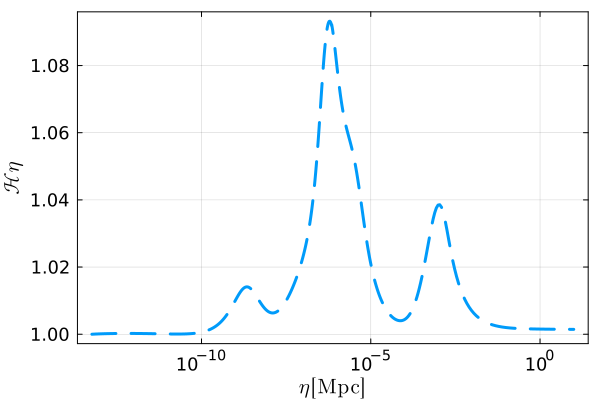

In [46]:
etalist = [norm*exp(i) for i in bgsol.t];
plot(etalist, map(x -> x*calHnorm(x), etalist), xscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$\mathcal{H}\eta$", legend=false)

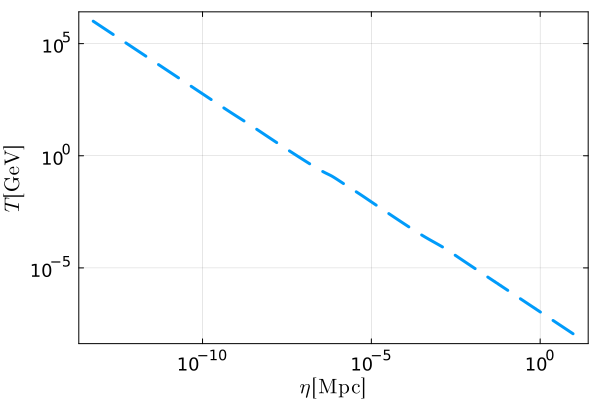

In [51]:
plot(Tnorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$T\,[\mathrm{GeV}]$", legend=false)

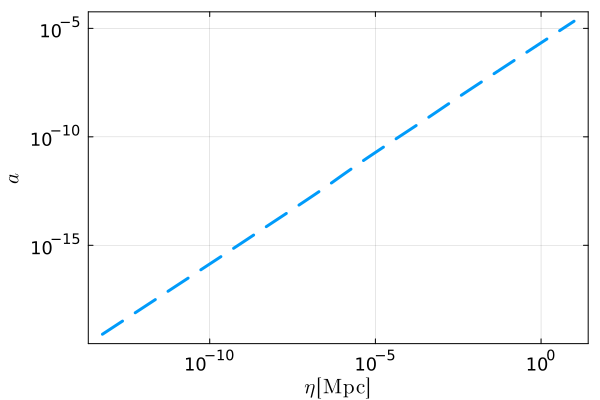

In [53]:
plot(anorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$a$", legend=false)

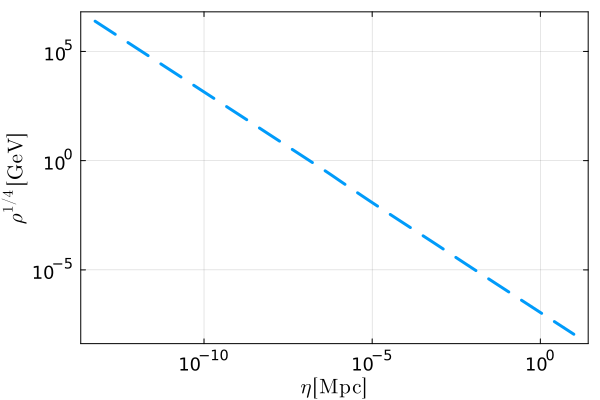

In [55]:
plot(rhoQnorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$\rho^{1/4}\,[\mathrm{GeV}]$")

In [57]:
EoSwsol(eta) = EoSw(Tnorm(eta));
cs2sol(eta) = cs2(Tnorm(eta));
grhosol(eta) = grho(Tnorm(eta));
gssol(eta) = gs(Tnorm(eta));

In [59]:
rhoQis1e4(eta) = rhoQnorm(eta) - 1e4;
eta1e4 = find_zero(rhoQis1e4, (etai*norm,1e-9))

1.39907215680605e-11

In [61]:
(rhoQnorm(eta1e4), EoSwsol(eta1e4), cs2sol(eta1e4))

(9999.999999999984, 0.33331897239417807, 0.333329074410855)

In [63]:
anorm(eta1e4)

1.9274322118625474e-17

In [65]:
anormList = [anorm(eta) for eta in etalist];
calHList = [calHnorm(eta) for eta in etalist];
EoSwList = [EoSwsol(eta) for eta in etalist];
cs2List = [cs2sol(eta) for eta in etalist];
grhoList = [grhosol(eta) for eta in etalist];
gsList = [gssol(eta) for eta in etalist];

In [67]:
writedlm("data/bg.csv", hcat(etalist,anormList,calHList,EoSwList,cs2List,grhoList,gsList), ',');

## load

In [4]:
bgdata = readdlm("data/bg.csv", ',');

etaList = bgdata[:,1];
anormList = bgdata[:,2];
calHList = bgdata[:,3];
EoSwList = bgdata[:,4];
cs2List = bgdata[:,5];
grhoList = bgdata[:,6];
gsList = bgdata[:,7];

In [5]:
lnetaList = log10.(etaList);
etai = etaList[1];
etaf = etaList[length(etaList)];

alneta = Spline1D(lnetaList, anormList, k=3);
aint(eta) = alneta(log10(eta))
calHlneta = Spline1D(lnetaList, calHList, k=3);
calHint(eta) = calHlneta(log10(eta));
EoSwlneta = Spline1D(lnetaList, EoSwList, k=3);
EoSwint(eta) = EoSwlneta(log10(eta))
cs2lneta = Spline1D(lnetaList, cs2List, k=3);
cs2int(eta) = cs2lneta(log10(eta));
grholneta = Spline1D(lnetaList, grhoList, k=3);
grhoint(eta) = grholneta(log10(eta))
gslneta = Spline1D(lnetaList, gsList, k=3);
gsint(eta) = gslneta(log10(eta));

In [6]:
(etai, etaf)

(5.780118550402413e-14, 9.893722796297363)

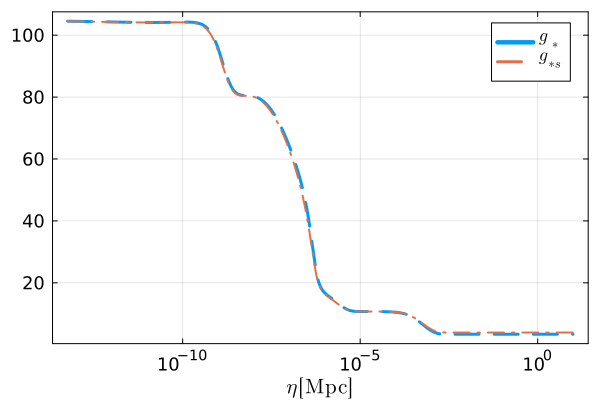

In [7]:
plot(grhoint, etaList, xscale=:log10, label=L"$g_*$", xlabel=L"$\eta\,[\mathrm{Mpc}]$", legend=true)
plot!(gsint, etaList, label=L"$g_{*s}$", linewidth=:2)

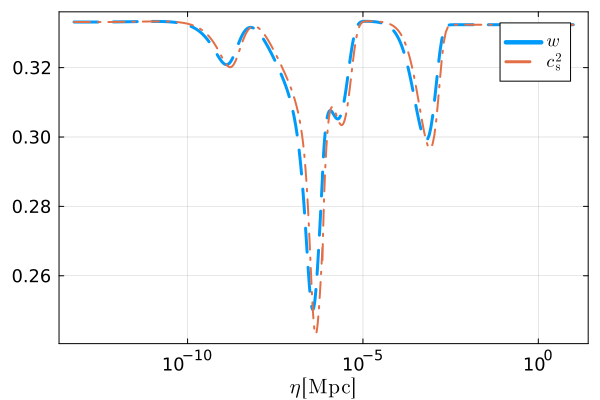

In [8]:
plot(EoSwint, etaList, xscale=:log10, label=L"$w$", xlabel=L"$\eta\,[\mathrm{Mpc}]$", legend=true)
plot!(cs2int, etaList, label=L"$c_\mathrm{s}^2$", linewidth=:2)

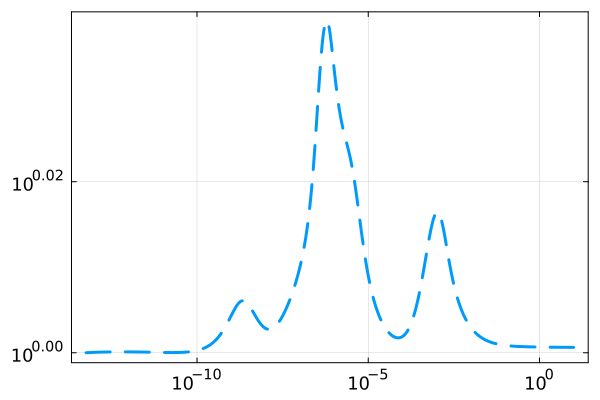

In [9]:
plot(etaList, map(x -> x*calHint(x), etaList), xscale=:log10, yscale=:log10)

In [10]:
(aint(400/1e5)*calHint(400/1e5)/aint(etaf)/calHint(etaf))^2

0.9773074407487163

In [11]:
etaf/aint(etaf)

463836.5609196693

In [12]:
2.4e4/0.07

342857.14285714284

# Scalar

## calculation

In [13]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 0.01;
xf = 400;

In [14]:
PhiRD(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhipRD(x) = ForwardDiff.derivative(PhiRD,x);

In [15]:
wsk2(k,eta) = cs2int(eta) + 3*calHint(eta)^2/k^2*(cs2int(eta) - EoSwint(eta));

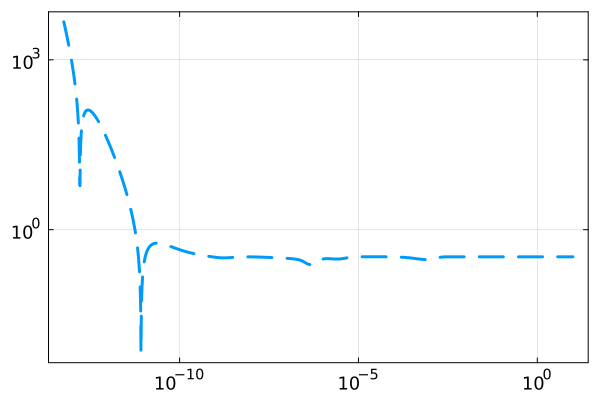

In [16]:
plot(etaList, map(x -> abs(wsk2(1e9,x)),etaList), xscale=:log10, yscale=:log10)

In [17]:
typeof(Float64(PhiRD(big(xi))))

Float64

In [20]:
function scalarEoM(du,u,p,x) # u[i] = Phi, u[i+length(kList)] = dPhidx, p[i] = k
    for i=1:length(kList)
        eta = x/p[i]
        du[i] = u[i+length(kList)]
        du[i+length(kList)] = - 3*calHint(eta)/p[i]*(1 + cs2int(eta))*u[i+length(kList)] - wsk2(p[i],eta)*u[i]
    end
end;

ui = vcat([Float64(PhiRD(big(xi))) for i=1:length(kList)], [Float64(PhipRD(big(xi))) for i=1:length(kList)]);
xspan = (xi,xf);

scalarprob = ODEProblem(scalarEoM,ui,xspan,kList);

In [22]:
@time scalarsol = solve(scalarprob,Tsit5(),reltol=1e-10,abstol=1e-10);

106.589269 seconds (845.22 M allocations: 13.365 GiB, 1.31% gc time, 0.88% compilation time)


In [24]:
scalarsol.t

5500-element Vector{Float64}:
   0.01
   0.010028508378921393
   0.010045128972614024
   0.010068493451259063
   0.010086388615347002
   0.010103753238397158
   0.010106323256477248
   0.010108496336585381
   0.010111683735467275
   0.010113778437959926
   0.010114893881907883
   0.01011808184145689
   0.010119828205552663
   ⋮
 395.04683963631203
 395.5172921946884
 395.9872009290829
 396.45602036385674
 396.9235496038483
 397.3900288103263
 397.8559796355627
 398.32210640330607
 398.7891323777102
 399.2576377430213
 399.7278764600536
 400.0

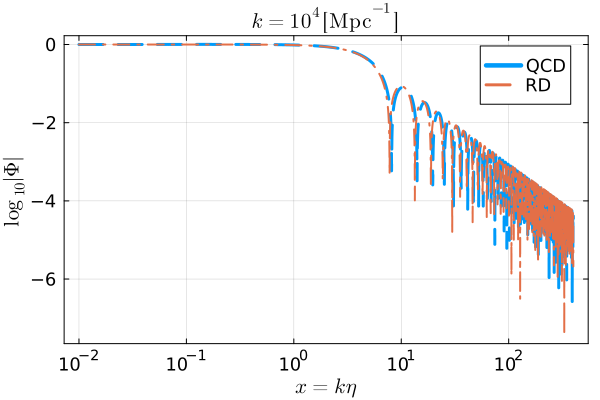

In [27]:
plot(scalarsol.t, log10.(abs.(hcat(scalarsol.u...)[1,:])), xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label="QCD", legend=true)
plot!(scalarsol.t, map(x -> log10(abs(PhiRD(big(x)))), scalarsol.t), label="RD", linewidth=:2)

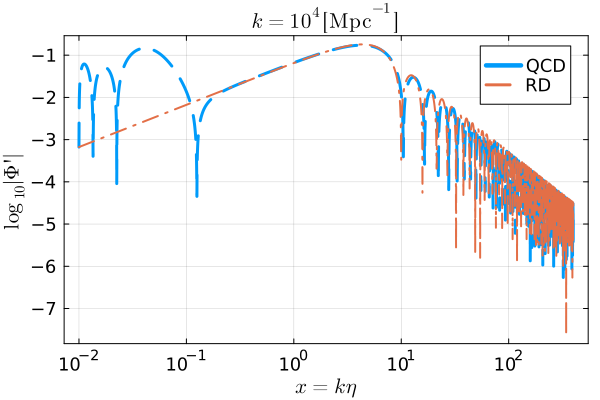

In [28]:
plot(scalarsol.t, log10.(abs.(hcat(scalarsol.u...)[1+length(kList),:])), xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi'|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label="QCD", legend=true)
plot!(scalarsol.t, map(x -> log10(abs(PhipRD(big(x)))), scalarsol.t), label="RD", linewidth=:2)

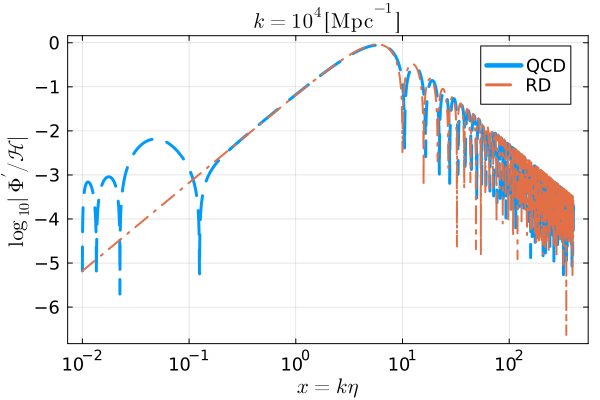

In [29]:
plot(scalarsol.t, [log10(abs(scalarsol.u[i][1+length(kList)] / calHint(scalarsol.t[i]))) for i=1:length(scalarsol.t)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi^\prime/\mathcal{H}|$", 
    title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label="QCD", legend=true)
plot!(scalarsol.t, map(x -> log10(abs(PhipRD(big(x)) / calHint(x))), scalarsol.t), label="RD", linewidth=:2)

In [30]:
writedlm("data/scalar.csv", vcat(hcat(scalarsol.t...),hcat(scalarsol.u...)), ',');

## load

In [11]:
PhiRD1(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhiRD2(x) = 9/x^2 * (cos(x/sqrt(3))/(x/sqrt(3)) + sin(x/sqrt(3)));
PhipRD1(x) = ForwardDiff.derivative(PhiRD1,x);
PhipRD2(x) = ForwardDiff.derivative(PhiRD2,x);
MPhi(x) = [PhiRD1(x) PhiRD2(x); PhipRD1(x) PhipRD2(x)];
PhiRDc(x,xc,Phic,Pic) = (MPhi(x)*inv(MPhi(xc))*[Phic,Pic])[1];
PhipRDc(x,xc,Phic,Pic) = (MPhi(x)*inv(MPhi(xc))*[Phic,Pic])[2];

In [13]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];
lnkList = log10.(kList);

xi = 1e-2;
xf = 400;

scalardata = readdlm("data/scalar.csv", ',');
xList = scalardata[1,:];
PhiList = scalardata[2:1+length(kList),:];
PiList = scalardata[2+length(kList):size(scalardata)[1],:];

PhiCSI = Spline2D(lnkList,xList,PhiList,kx=3,ky=3);
PiCSI = Spline2D(lnkList,xList,PiList,kx=3,ky=3);

function Phiint(k,x) 
    if x < xi
        return PhiRD1(x)
    elseif x > xf
        return PhiRDc(x,xf,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else 
        return PhiCSI(log10(k),x)
    end
end;

function Piint(k,x) 
    if x < xi
        return PhipRD1(x)
    elseif x > xf
        return PhipRDc(x,xf,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else 
        return PiCSI(log10(k),x)
    end
end;

In [139]:
lnxplotList = [10^lnx for lnx=-3:0.01:3];
xplotList = [x for x=xi:0.01:500];

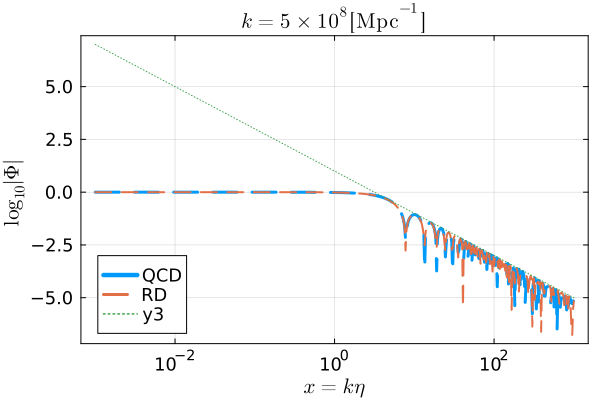

In [143]:
plot(lnxplotList, [log10(abs(Phiint(5e8,lnxplotList[i]))) for i=1:length(lnxplotList)], 
    xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", 
    title=L"$k = 5\times10^8\,[\mathrm{Mpc}^{-1}]$", legend=:bottomleft, label="QCD")
plot!(lnxplotList, [log10(abs(PhiRD1(lnxplotList[i]))) for i=1:length(lnxplotList)], label="RD", linestyle=:dash, linewidth=:2)
plot!(lnxplotList, [log10(10*lnxplotList[i]^-2) for i=1:length(lnxplotList)], linestyle=:dot, linewidth=:1)

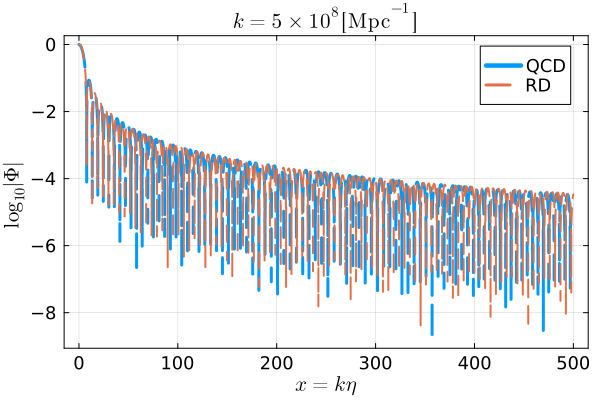

In [147]:
plot(xplotList, [log10(abs(Phiint(5e8,xplotList[i]))) for i=1:length(xplotList)], 
    xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", 
    title=L"$k = 5\times10^8\,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xplotList, [log10(abs(PhiRD1(xplotList[i]))) for i=1:length(xplotList)], label="RD", linestyle=:dash, linewidth=:2)

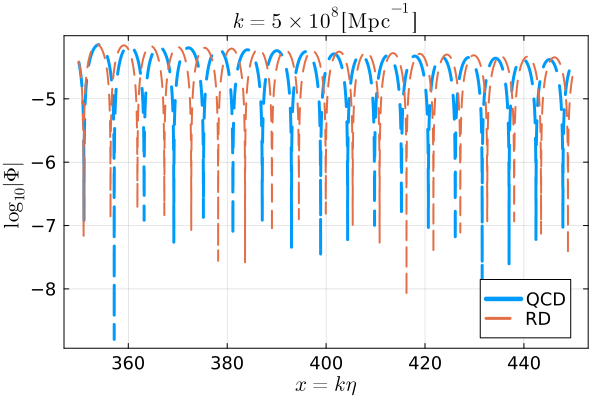

In [151]:
xzoom  = [x for x=350:0.01:450];

plot(xzoom, [log10(abs(Phiint(5e8,xzoom[i]))) for i=1:length(xzoom)], 
    xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", 
    title=L"$k = 5\times10^8\,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xzoom, [log10(abs(PhiRD1(xzoom[i]))) for i=1:length(xzoom)], label="RD", linestyle=:dash, linewidth=:2)

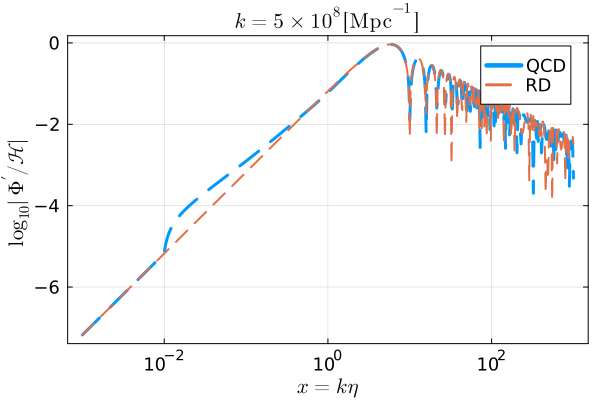

In [155]:
plot(lnxplotList, [log10(abs(Piint(5e8,big(lnxplotList[i]))*5e8 / calHint(lnxplotList[i]/5e8))) 
        for i=1:length(lnxplotList)], xscale=:log10, xlabel=L"$x = k\eta$", 
    ylabel=L"$\log_{10}|\Phi^\prime / \mathcal{H}|$", title=L"$k = 5\times10^8 \,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(lnxplotList, [log10(abs(PhipRD1(big(lnxplotList[i])) *lnxplotList[i])) 
        for i=1:length(lnxplotList)], label="RD", linestyle=:dash, linewidth=:2)

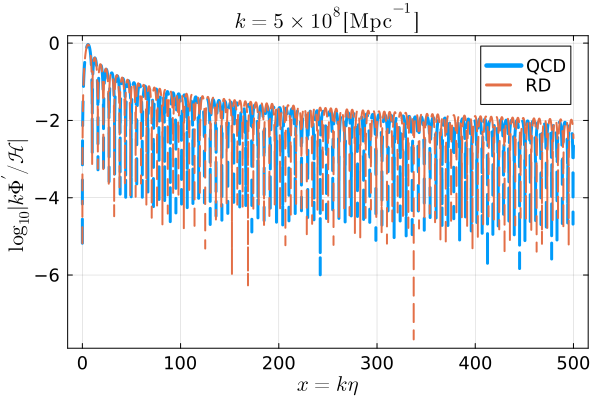

In [159]:
plot(xplotList, [log10(abs(Piint(5e8,big(xplotList[i])) *5e8 / calHint(xplotList[i]/5e8))) 
        for i=1:length(xplotList)], xlabel=L"$x = k\eta$", 
    ylabel=L"$\log_{10}|k\Phi^\prime / \mathcal{H}|$", title=L"$k = 5\times10^8 \,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xplotList, [log10(abs(PhipRD1(big(xplotList[i])) *xplotList[i])) 
        for i=1:length(xplotList)], label="RD", linestyle=:dash, linewidth=:2)

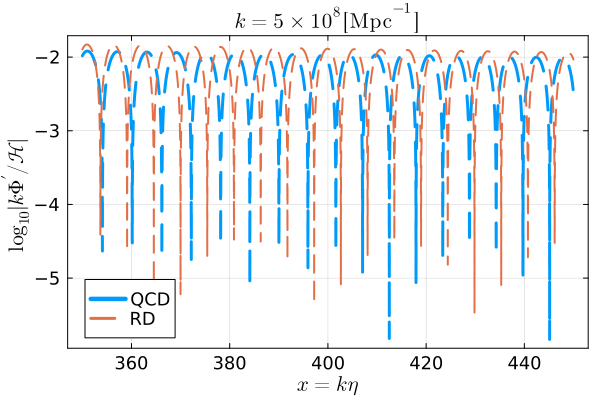

In [163]:
plot(xzoom, [log10(abs(Piint(5e8,big(xzoom[i])) *5e8 / calHint(xzoom[i]/5e8))) 
        for i=1:length(xzoom)], xlabel=L"$x = k\eta$", 
    ylabel=L"$\log_{10}|k\Phi^\prime / \mathcal{H}|$", title=L"$k = 5\times10^8 \,[\mathrm{Mpc}^{-1}]$", legend=true, label="QCD")
plot!(xzoom, [log10(abs(PhipRD1(big(xzoom[i])) *xzoom[i])) 
        for i=1:length(xzoom)], label="RD", linestyle=:dash, linewidth=:2)

In [167]:
aRD(eta) = eta/etaf*aint(etaf);

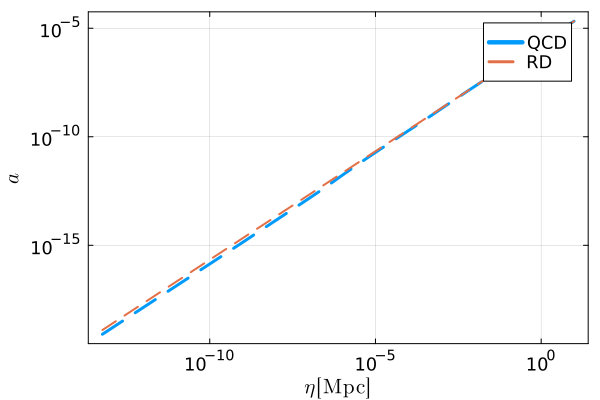

In [171]:
etalist = [10^lneta for lneta=log10(etai):0.01:log10(etaf)];

plot(aint, etalist, xscale=:log10, yscale=:log10, 
    xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$a$", legend=true, label="QCD")
plot!(aRD, etalist, linestyle=:dash, linewidth=:2, label="RD")

In [175]:
ks = 1e8;
lnxzoom = [10^lnx for lnx=-2:0.01:2];

sourceQCD1e8(x) = aint(x/ks)* (2*Phiint(ks,x)*Phiint(ks,x) 
    + 4/3/(1+EoSwint(x/ks))*(Phiint(ks,x)+Piint(ks,x)*ks/calHint(x/ks))^2);

sourceRD1e8(x) = aRD(x/ks)* (2*PhiRD1(x)*PhiRD1(x) + (PhiRD1(x)+PhipRD1(x)*x)^2);

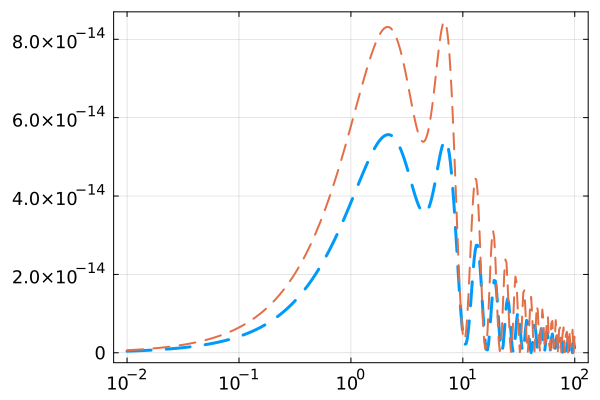

In [179]:
plot(lnxzoom, [sourceQCD1e8(lnxzoom[i]) for i=1:length(lnxzoom)], xscale=:log10)
plot!(lnxzoom, [sourceRD1e8(lnxzoom[i]) for i=1:length(lnxzoom)], linestyle=:dash, linewidth=:2)

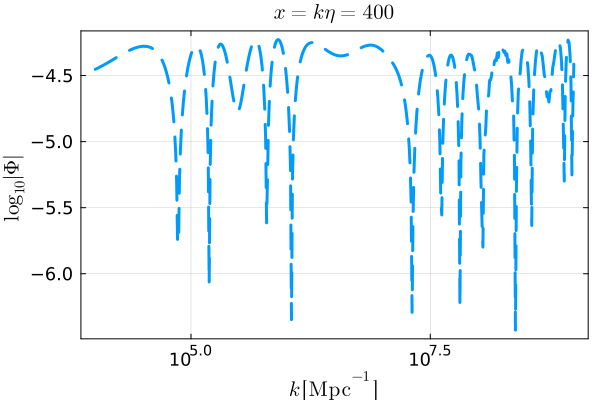

In [183]:
plot(kList, [log10(abs(Phiint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|\Phi|$", title=L"$x = k\eta = 400$")

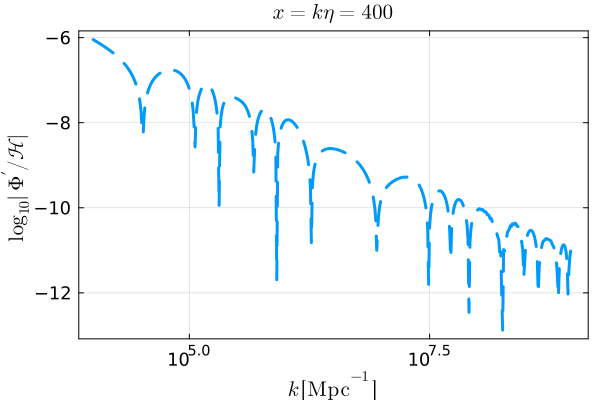

In [187]:
plot(kList, [log10(abs(Piint(kList[i],xf) / calHint(xf/kList[i]))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k \,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|\Phi^\prime / \mathcal{H}|$", 
    title=L"$x = k\eta = 400$")

# Tensor

## calculation

In [177]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];
lnkList = log10.(kList);

xi = 1e-2;
xf = 400;

In [113]:
function gkEoM(du,u,p,x) # u[i] = g, u[i+length(kList)] = dgdx, p[i] = k
    for i=1:length(kList)
        du[i] = u[i+length(kList)]
        du[i+length(kList)] = - (1 - (1-3*EoSwint(x/p[i]))/2*calHint(x/p[i])^2/p[i]^2)*u[i]
    end
end;

xspan = (xi, xf);

In [115]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);

In [117]:
ui1 = vcat([g1RD(xi) for i=1:length(kList)], [g1pRD(xi) for i=1:length(kList)]);
ui2 = vcat([g2RD(xi) for i=1:length(kList)], [g2pRD(xi) for i=1:length(kList)]);

g1prob = ODEProblem(gkEoM,ui1,xspan,kList);
g2prob = ODEProblem(gkEoM,ui2,xspan,kList);

@time g1sol = solve(g1prob,Tsit5(),reltol=1e-10,abstol=1e-10);
@time g2sol = solve(g2prob,Tsit5(),reltol=1e-10,abstol=1e-10);

 98.898597 seconds (1.15 G allocations: 18.605 GiB, 1.38% gc time, 0.11% compilation time)
 84.240735 seconds (985.58 M allocations: 15.978 GiB, 0.79% gc time)


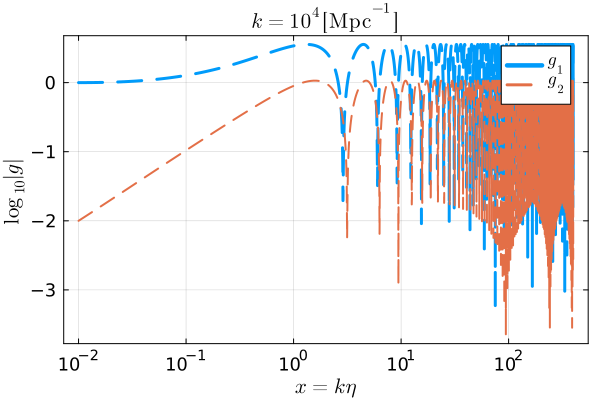

In [118]:
plot(g1sol.t, log10.(abs.(hcat(g1sol.u...)[1,:])), xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(g2sol.t, log10.(abs.(hcat(g2sol.u...)[1,:])), label=L"$g_2$", linestyle=:dash, linewidth=:2)

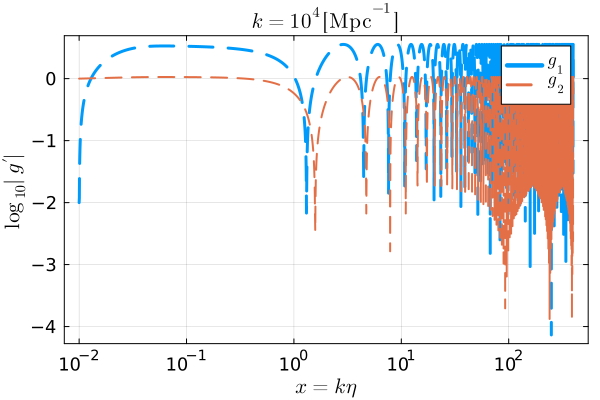

In [119]:
plot(g1sol.t, log10.(abs.(hcat(g1sol.u...)[1+length(kList),:])), xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(g2sol.t, log10.(abs.(hcat(g2sol.u...)[1+length(kList),:])), xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

In [120]:
writedlm("data/g1.csv", vcat(hcat(g1sol.t...),hcat(g1sol.u...)), ',');
writedlm("data/g2.csv", vcat(hcat(g2sol.t...),hcat(g2sol.u...)), ',');

In [121]:
hkRD(x) = sin(x)/x;
hpRD(x) = ForwardDiff.derivative(hkRD,x);

In [122]:
function hkEoM(du,u,p,x) # u[i] = h, u[i+length(kList)] = dhdx, p[i] = k
    for i=1:length(kList)
        du[i] = u[i+length(kList)]
        du[i+length(kList)] = -2*calHint(x/p[i])/p[i]*u[i+length(kList)] - u[i]
    end
end;

xspan = (xi, xf);
ui = vcat([hkRD(xi) for i=1:length(kList)], [hpRD(xi) for i=1:length(kList)]);

hkprob = ODEProblem(hkEoM,ui,xspan,kList);

In [123]:
@time hksol = solve(hkprob,Tsit5(),reltol=1e-10,abstol=1e-10);

 22.069721 seconds (270.97 M allocations: 4.581 GiB, 3.22% gc time, 0.46% compilation time)


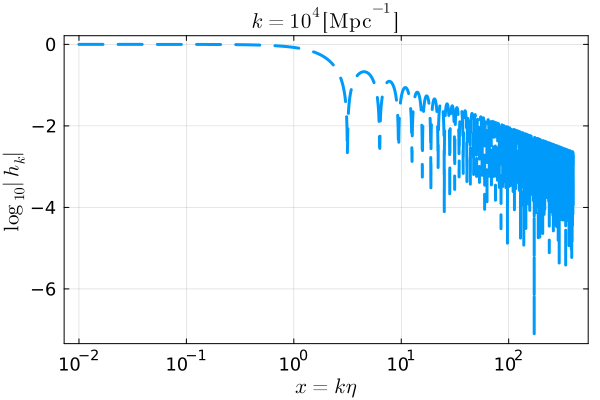

In [124]:
plot(hksol.t, log10.(abs.(hcat(hksol.u...)[1,:])), xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|h_k|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

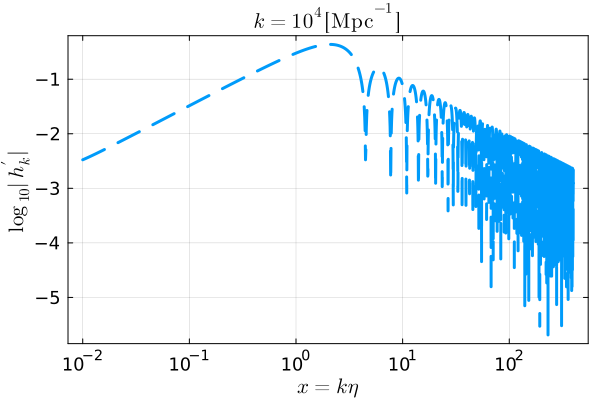

In [125]:
plot(hksol.t, log10.(abs.(hcat(hksol.u...)[1+length(kList),:])), xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|h_k^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

In [126]:
writedlm("data/hk.csv", vcat(hcat(hksol.t...),hcat(hksol.u...)), ',');

In [179]:
g1data = readdlm("data/g1.csv",',');
x1List = g1data[1,:];
g1List = g1data[2:1+length(kList),:];
g1pList = g1data[2+length(kList):size(g1data)[1],:];

g2data = readdlm("data/g2.csv",',');
x2List = g2data[1,:];
g2List = g2data[2:1+length(kList),:];
g2pList = g2data[2+length(kList):size(g2data)[1],:];

g1CSI = Spline2D(lnkList,x1List,g1List,kx=3,ky=3);
g1pCSI = Spline2D(lnkList,x1List,g1pList,kx=3,ky=3);
g2CSI = Spline2D(lnkList,x2List,g2List,kx=3,ky=3);
g2pCSI = Spline2D(lnkList,x2List,g2pList,kx=3,ky=3);

g1int(k,x) = g1CSI(log10(k),x);
g1pint(k,x) = g1pCSI(log10(k),x);
g2int(k,x) = g2CSI(log10(k),x);
g2pint(k,x) = g2pCSI(log10(k),x);

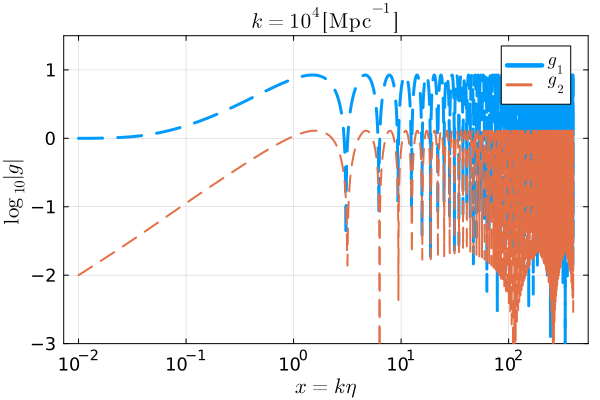

In [181]:
plot(x1List, [log10(abs(g1int(1e5,x1List[i]))) for i=1:length(x1List)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    ylims=(-3,1.5), legend=true)
plot!(x2List, [log10(abs(g2int(1e5,x2List[i]))) for i=1:length(x2List)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

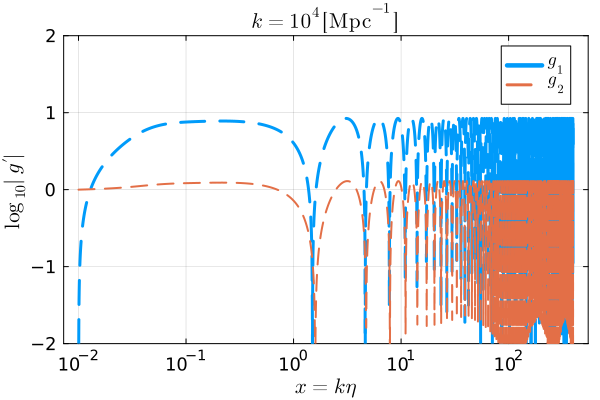

In [183]:
plot(x1List, [log10(abs(g1pint(1e5,x1List[i]))) for i=1:length(x1List)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    ylims=(-2,2), legend=true)
plot!(x2List, [log10(abs(g2pint(1e5,x2List[i]))) for i=1:length(x2List)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

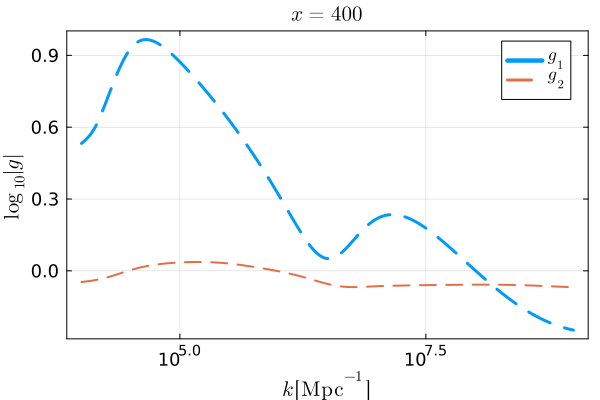

In [184]:
plot(kList, [log10(abs(g1int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

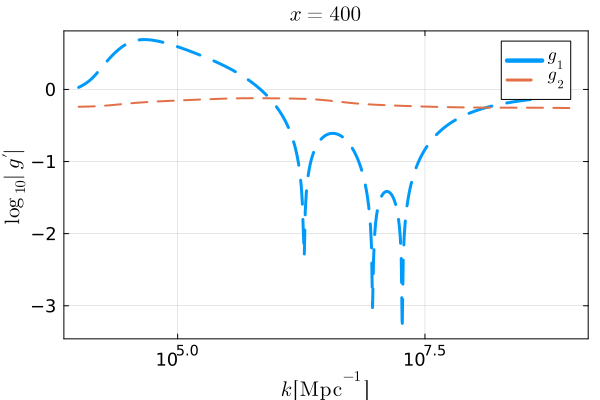

In [187]:
plot(kList, [log10(abs(g1pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

In [189]:
normNk(k,x) = g1pint(k,x)g2int(k,x)-g2pint(k,x)g1int(k,x);

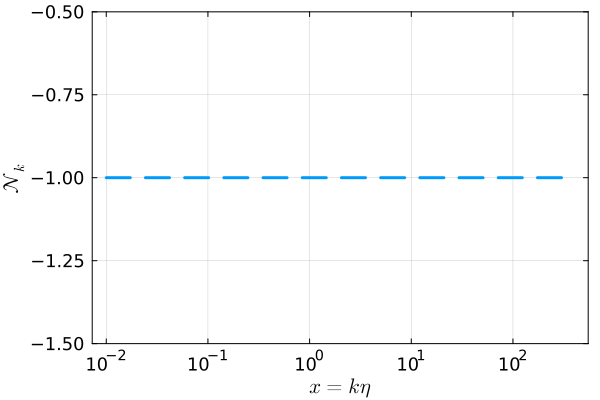

In [191]:
plot(x1List, [normNk(1e5,x1List[i]) for i=1:length(x1List)], xscale=:log10, ylims=(-1.5,-0.5), xlabel=L"$x = k\eta$", ylabel=L"$\mathcal{N}_k$")

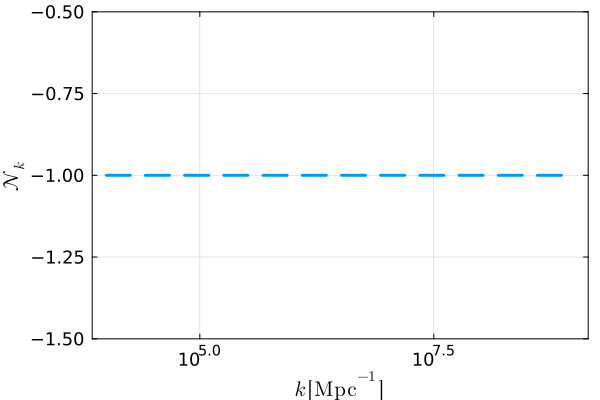

In [193]:
plot(kList, [normNk(kList[i],xi) for i=1:length(kList)], xscale=:log10, ylims=(-1.5,-0.5), xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\mathcal{N}_k$")

In [195]:
dx = 2*2*π;

function g1g1bar(k)
    f(x) = g1int(k,x)*g1int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g2g2bar(k)
    f(x) = g2int(k,x)*g2int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g1g2bar(k)
    f(x) = g1int(k,x)*g2int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

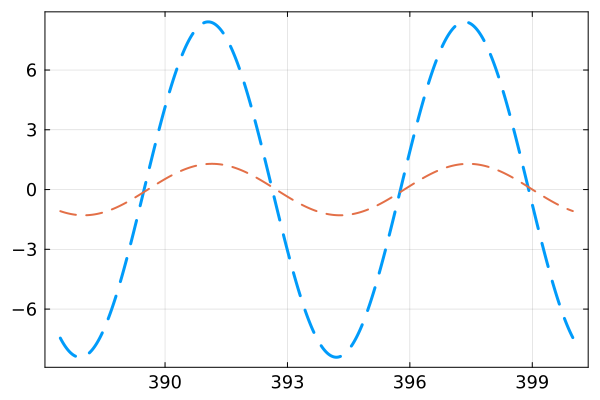

In [197]:
lastxList = [x for x=xf-dx:0.01:xf];

plot(lastxList, [g1int(1e5,lastxList[i]) for i=1:length(lastxList)])
plot!(lastxList, [g2int(1e5,lastxList[i]) for i=1:length(lastxList)], linestyle=:dash, linewidth=:2)

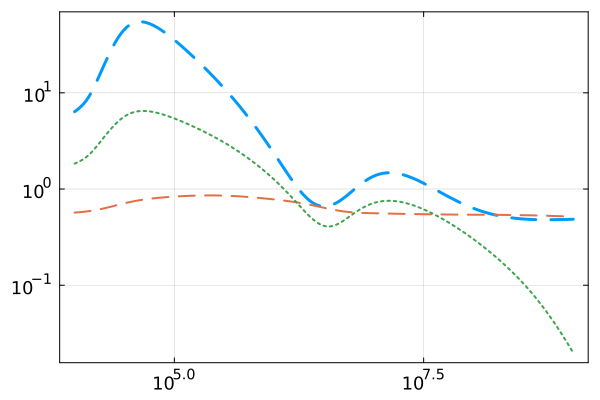

In [199]:
plot(kList, [g1g1bar(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)
plot!(kList, [g2g2bar(kList[i]) for i=1:length(kList)], linestyle=:dash, linewidth=:2)
plot!(kList, [g1g2bar(kList[i]) for i=1:length(kList)], linestyle=:dot, linewidth=:2)

In [200]:
hkdata = readdlm("data/hk.csv",',');
xList = hkdata[1,:];
hkList = hkdata[2:1+length(kList),:];
hpList = hkdata[2+length(kList):size(hkdata)[1],:];

hkCSI = Spline2D(lnkList,xList,hkList,kx=3,ky=3);
hpCSI = Spline2D(lnkList,xList,hpList,kx=3,ky=3);

hint(k,x) = hkCSI(log10(k),x);
hpint(k,x) = hpCSI(log10(k),x);

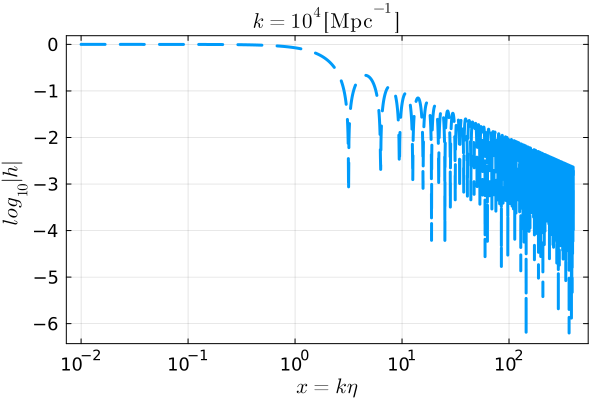

In [201]:
plot(xList, [log10(abs(hint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$log_{10}|h|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

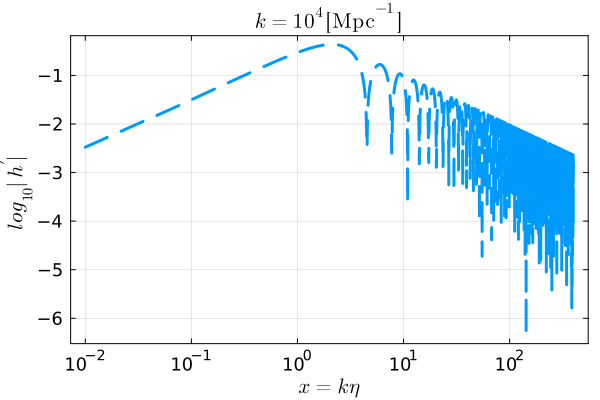

In [202]:
plot(xList, [log10(abs(hpint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$log_{10}|h^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

In [203]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [205]:
hRD(x) = sin(x)/x;
h2intRD(x) = hRD(x)*hRD(x);
h2barRD = quadgk(h2intRD,xf-dx,xf)[1]/dx

3.23370052209608e-6

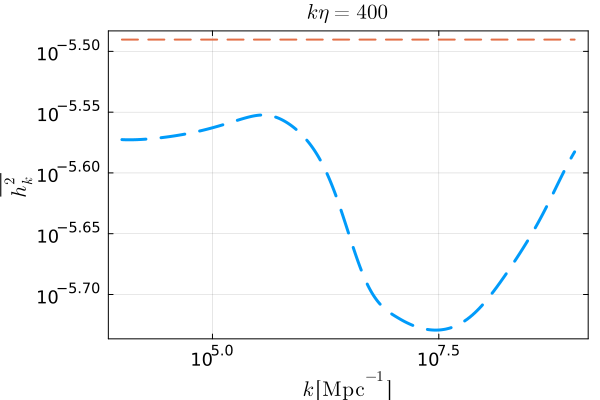

In [206]:
plot(kList, [h2bar(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10, ylabel=L"\overline{h_k^2}", xlabel=L"k\,[\mathrm{Mpc}^{-1}]", title=L"k\eta=400")
plot!(kList, [h2barRD for i=1:length(kList)], linestyle=:dash, linewidth=:2)

In [207]:
h2barRD/h2bar(1e5)

1.181817213227126

In [208]:
g1g1List = [g1g1bar(kList[i]) for i=1:length(kList)];
g1g2List = [g1g2bar(kList[i]) for i=1:length(kList)];
g2g2List = [g2g2bar(kList[i]) for i=1:length(kList)];
coeffList = [(aint(xf/kList[i])*calHint(xf/kList[i])/aint(etaf)/calHint(etaf))^2 /24*(kList[i]/calHint(xf/kList[i]))^2 #*64/81/aint(xf/kList[i])^2 
    for i=1:length(kList)];
OlinList = [(aint(xf/kList[i])*calHint(xf/kList[i])/aint(etaf)/calHint(etaf))^2 /12*(kList[i]/calHint(xf/kList[i]))^2 * h2bar(kList[i]) for i=1:length(kList)];

In [209]:
writedlm("data/g1g2coeff.csv", hcat(log10.(kList),g1g1List,g1g2List,g2g2List,coeffList,OlinList), ',');

## load

In [25]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);
Mg(x) = [g1RD(x) g2RD(x); g1pRD(x) g2pRD(x)];
gRDc(x,xc,gc,gpc) = (Mg(x)*inv(Mg(xc))*[gc,gpc])[1];
gpRDc(x,xc,gc,gpc) = (Mg(x)*inv(Mg(xc))*[gc,gpc])[2];

In [31]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];
lnkList = log10.(kList);

xi = 1e-2;
xf = 400;

g1data = readdlm("data/g1.csv", ',');
x1List = g1data[1,:];
g1List = g1data[2:1+length(kList),:];
g1pList = g1data[2+length(kList):size(g1data)[1],:];

g2data = readdlm("data/g2.csv", ',');
x2List = g2data[1,:];
g2List = g2data[2:1+length(kList),:];
g2pList = g2data[2+length(kList):size(g2data)[1],:];

g1CSI = Spline2D(lnkList,x1List,g1List,kx=3,ky=3);
g1pCSI = Spline2D(lnkList,x1List,g1pList,kx=3,ky=3);
g2CSI = Spline2D(lnkList,x2List,g2List,kx=3,ky=3);
g2pCSI = Spline2D(lnkList,x2List,g2pList,kx=3,ky=3);

function g1int(k,x) 
    if x < xi
        return g1RD(x)
    elseif x > xf
        return gRDc(x,xf,g1CSI(log10(k),xf),g1pCSI(log10(k),xf))
    else 
        return g1CSI(log10(k),x)
    end
end;

function g1pint(k,x) 
    if x < xi
        return g1pRD(x)
    elseif x > xf
        return gpRDc(x,xf,g1CSI(log10(k),xf),g1pCSI(log10(k),xf))
    else 
        return g1pCSI(log10(k),x)
    end
end;

function g2int(k,x) 
    if x < xi
        return g2RD(x)
    elseif x > xf
        return gRDc(x,xf,g2CSI(log10(k),xf),g2pCSI(log10(k),xf))
    else 
        return g2CSI(log10(k),x)
    end
end;

function g2pint(k,x) 
    if x < xi
        return g2pRD(x)
    elseif x > xf
        return gpRDc(x,xf,g2CSI(log10(k),xf),g2pCSI(log10(k),xf))
    else 
        return g2pCSI(log10(k),x)
    end
end;

In [33]:
xplotList = [10^lnx for lnx=-3:0.01:3];

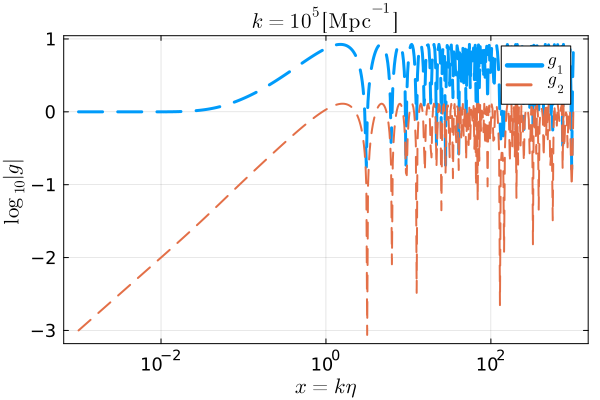

In [35]:
plot(xplotList, [log10(abs(g1int(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", 
    label=L"$g_1$", legend=true)
plot!(xplotList, [log10(abs(g2int(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

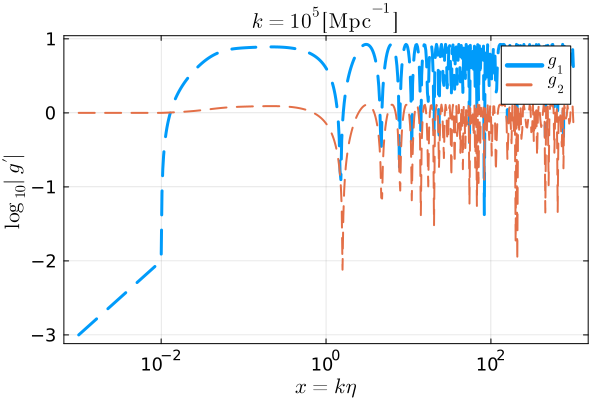

In [37]:
plot(xplotList, [log10(abs(g1pint(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", 
    label=L"$g_1$", legend=true)
plot!(xplotList, [log10(abs(g2pint(1e5,xplotList[i]))) for i=1:length(xplotList)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

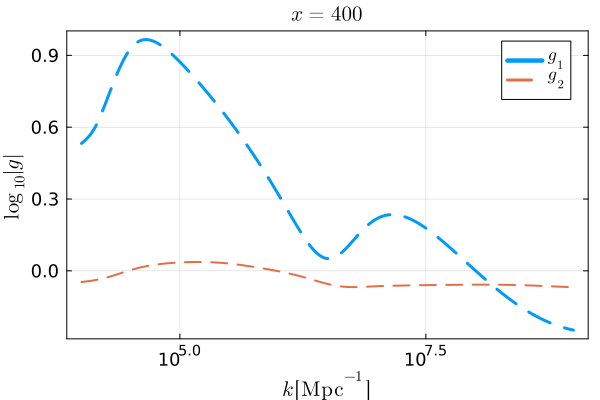

In [39]:
plot(kList, [log10(abs(g1int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

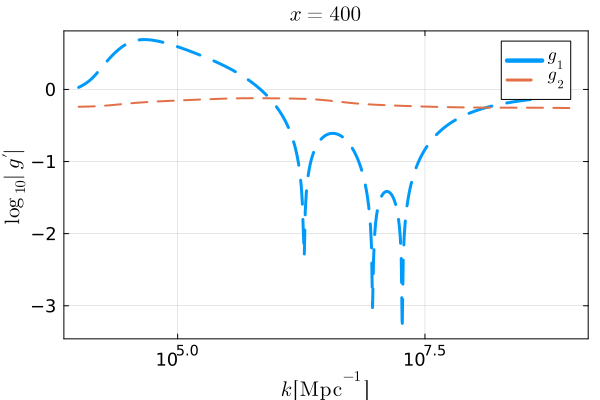

In [41]:
plot(kList, [log10(abs(g1pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$", linestyle=:dash, linewidth=:2)

In [45]:
coeffdata = readdlm("data/g1g2coeff.csv", ',');

lnkList = coeffdata[:,1];
g1g1List = coeffdata[:,2];
g1g2List = coeffdata[:,3];
g2g2List = coeffdata[:,4];
coeffList = coeffdata[:,5];
OlinList = coeffdata[:,6];

In [47]:
g1g1CSI = Spline1D(lnkList, g1g1List, k=3);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = Spline1D(lnkList, g1g2List, k=3);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = Spline1D(lnkList, g2g2List, k=3);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = Spline1D(lnkList, coeffList, k=3);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = Spline1D(lnkList, OlinList, k=3);
Olinint(k) = OlinCSI(log10(k));

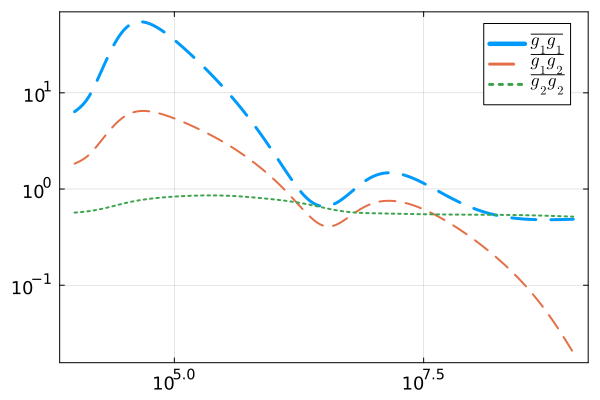

In [49]:
plot(kList, [g1g1int(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10, legend=true, label=L"\overline{g_1g_1}")
plot!(kList, [g1g2int(kList[i]) for i=1:length(kList)], label=L"\overline{g_1g_2}", linestyle=:dash, linewidth=:2)
plot!(kList, [g2g2int(kList[i]) for i=1:length(kList)], label=L"\overline{g_2g_2}", linestyle=:dot, linewidth=:2)

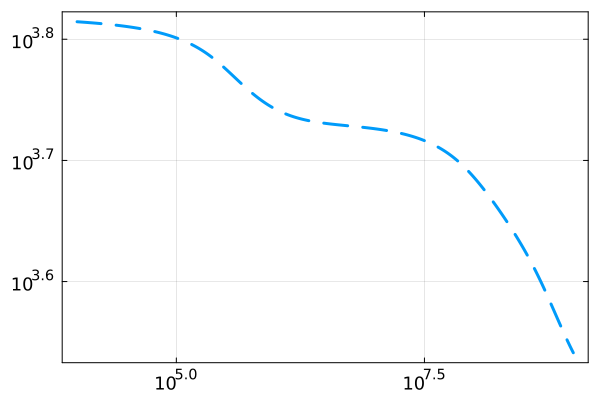

In [51]:
plot(kList, [coeffint(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)

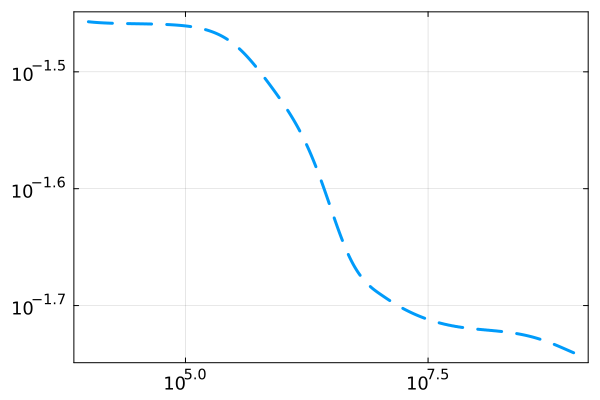

In [53]:
plot(kList, [Olinint(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)

In [55]:
kIR = 1e6;

g1int(kIR,kIR/5e8)^2*g2g2int(kIR) - 2*g1int(kIR,kIR/5e8)*g2int(kIR,kIR/5e8)*g1g2int(kIR) + g2int(kIR,kIR/5e8)^2*g1g1int(kIR)

0.7742367508302154

# Kernel

## calculation

In [4]:
bgdata = readdlm("data/bg.csv", ',');

etaList = bgdata[:,1];
anormList = bgdata[:,2];
calHList = bgdata[:,3];
EoSwList = bgdata[:,4];
cs2List = bgdata[:,5];
grhoList = bgdata[:,6];
gsList = bgdata[:,7];

In [5]:
lnetaList = log10.(etaList);
etai = etaList[1];
etaf = etaList[length(etaList)];

alneta = Spline1D(lnetaList, anormList, k=3);
aint(eta) = alneta(log10(eta))
calHlneta = Spline1D(lnetaList, calHList, k=3);
calHint(eta) = calHlneta(log10(eta));
EoSwlneta = Spline1D(lnetaList, EoSwList, k=3);
EoSwint(eta) = EoSwlneta(log10(eta))
cs2lneta = Spline1D(lnetaList, cs2List, k=3);
cs2int(eta) = cs2lneta(log10(eta));
grholneta = Spline1D(lnetaList, grhoList, k=3);
grhoint(eta) = grholneta(log10(eta))
gslneta = Spline1D(lnetaList, gsList, k=3);
gsint(eta) = gslneta(log10(eta));

In [6]:
PhiRD1(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhiRD2(x) = 9/x^2 * (cos(x/sqrt(3))/(x/sqrt(3)) + sin(x/sqrt(3)));
PhipRD1(x) = ForwardDiff.derivative(PhiRD1,x);
PhipRD2(x) = ForwardDiff.derivative(PhiRD2,x);
MPhi(x) = [PhiRD1(x) PhiRD2(x); PhipRD1(x) PhipRD2(x)];
PhiRDc(x,xc,Phic,Pic) = (MPhi(x)*inv(MPhi(xc))*[Phic,Pic])[1];
PhipRDc(x,xc,Phic,Pic) = (MPhi(x)*inv(MPhi(xc))*[Phic,Pic])[2];

In [7]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];
lnkList = log10.(kList);

xi = 1e-2;
xf = 400;

scalardata = readdlm("data/scalar.csv", ',');
xList = scalardata[1,:];
PhiList = scalardata[2:1+length(kList),:];
PiList = scalardata[2+length(kList):size(scalardata)[1],:];

PhiCSI = Spline2D(lnkList,xList,PhiList,kx=3,ky=3);
PiCSI = Spline2D(lnkList,xList,PiList,kx=3,ky=3);

function Phiint(k,x) 
    if x < xi
        return PhiRD1(x)
    elseif x > xf
        return PhiRDc(x,xf,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else 
        return PhiCSI(log10(k),x)
    end
end;

function Piint(k,x) 
    if x < xi
        return PhipRD1(x)
    elseif x > xf
        return PhipRDc(x,xf,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else 
        return PiCSI(log10(k),x)
    end
end;

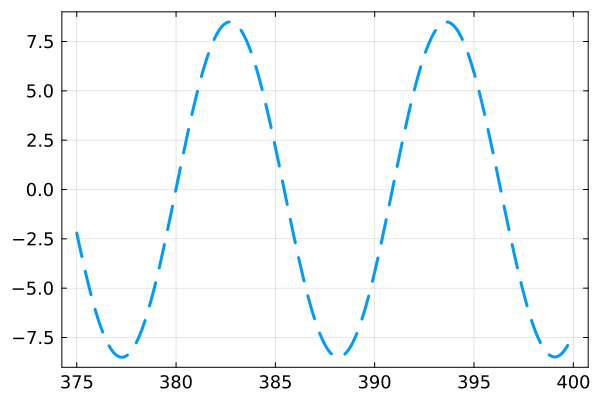

In [8]:
xzoom = [x for x=375:0.01:400];
plot(xzoom, map(x -> x^2*Phiint(1e5,x), xzoom))

In [9]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);
Mg(x) = [g1RD(x) g2RD(x); g1pRD(x) g2pRD(x)];
gRDc(x,xc,gc,gpc) = (Mg(x)*inv(Mg(xc))*[gc,gpc])[1];
gpRDc(x,xc,gc,gpc) = (Mg(x)*inv(Mg(xc))*[gc,gpc])[2];

In [10]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];
lnkList = log10.(kList);

xi = 1e-2;
xf = 400;

g1data = readdlm("data/g1.csv", ',');
x1List = g1data[1,:];
g1List = g1data[2:1+length(kList),:];
g1pList = g1data[2+length(kList):size(g1data)[1],:];

g2data = readdlm("data/g2.csv", ',');
x2List = g2data[1,:];
g2List = g2data[2:1+length(kList),:];
g2pList = g2data[2+length(kList):size(g2data)[1],:];

g1CSI = Spline2D(lnkList,x1List,g1List,kx=3,ky=3);
g1pCSI = Spline2D(lnkList,x1List,g1pList,kx=3,ky=3);
g2CSI = Spline2D(lnkList,x2List,g2List,kx=3,ky=3);
g2pCSI = Spline2D(lnkList,x2List,g2pList,kx=3,ky=3);

function g1int(k,x) 
    if x < xi
        return g1RD(x)
    elseif x > xf
        return gRDc(x,xf,g1CSI(log10(k),xf),g1pCSI(log10(k),xf))
    else 
        return g1CSI(log10(k),x)
    end
end;

function g1pint(k,x) 
    if x < xi
        return g1pRD(x)
    elseif x > xf
        return gpRDc(x,xf,g1CSI(log10(k),xf),g1pCSI(log10(k),xf))
    else 
        return g1pCSI(log10(k),x)
    end
end;

function g2int(k,x) 
    if x < xi
        return g2RD(x)
    elseif x > xf
        return gRDc(x,xf,g2CSI(log10(k),xf),g2pCSI(log10(k),xf))
    else 
        return g2CSI(log10(k),x)
    end
end;

function g2pint(k,x) 
    if x < xi
        return g2pRD(x)
    elseif x > xf
        return gpRDc(x,xf,g2CSI(log10(k),xf),g2pCSI(log10(k),xf))
    else 
        return g2pCSI(log10(k),x)
    end
end;

In [11]:
coeffdata = readdlm("data/g1g2coeff.csv", ',');

lnkList = coeffdata[:,1];
g1g1List = coeffdata[:,2];
g1g2List = coeffdata[:,3];
g2g2List = coeffdata[:,4];
coeffList = coeffdata[:,5];
OlinList = coeffdata[:,6];

In [12]:
g1g1CSI = Spline1D(lnkList, g1g1List, k=3);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = Spline1D(lnkList, g1g2List, k=3);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = Spline1D(lnkList, g2g2List, k=3);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = Spline1D(lnkList, coeffList, k=3);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = Spline1D(lnkList, OlinList, k=3);
Olinint(k) = OlinCSI(log10(k));

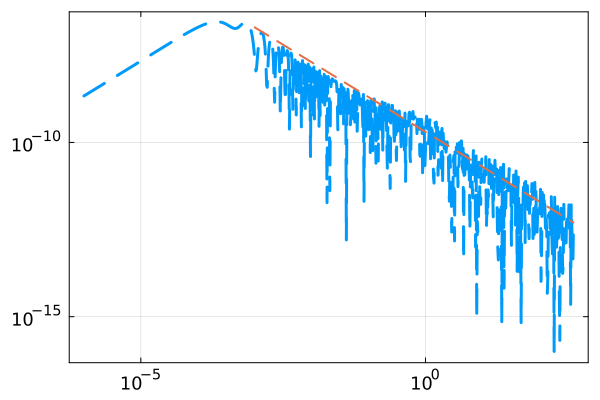

In [13]:
ks = 1e8;
kGW = 1e4;

I148int(x) = (4/9*aint(x/kGW)/aint(xf/kGW)*g1int(kGW,x) * (2*Phiint(ks,ks/kGW*x)^2
        + 4/3/(1+EoSwint(x/kGW))*(Phiint(ks,ks/kGW*x)+Piint(ks,ks/kGW*x)*ks/calHint(x/kGW))^2));

lnxplotList = [10^lnx for lnx=-6:0.01:log10(xf)];
lnxfit = [10^lnx for lnx=-3:0.01:log10(xf)];
plot(lnxplotList, map(x -> abs(I148int(x)), lnxplotList), xscale=:log10, yscale=:log10)
plot!(lnxfit, [2e-10*lnxfit[i]^-1 for i=1:length(lnxfit)], linestyle=:dash, linewidth=:2)

In [31]:
I148(x) = abs(quadgk(I148int,min(xi,kGW/ks*xi),x)[1]);
lnxcoarse = [10^lnx for lnx=-5:0.1:log10(xf)];

function I148List()
    I148List = zeros(length(lnxcoarse))
    Threads.@threads for i=1:length(lnxcoarse)
        I148List[i] = I148(lnxcoarse[i])
    end
    return I148List
end;

In [ ]:
@time I148data = I148List();

In [39]:
open("data/I148.dat","w") do out
    Base.print_array(out, I148data)
end;

In [112]:
f = open("data/I148.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

I148data = [numarray[i][1] for i=1:length(numarray)];

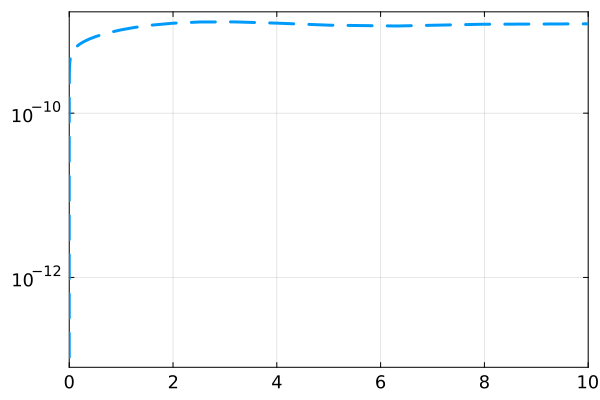

In [128]:
plot(lnxcoarse, I148data, yscale=:log10, xlims=(0,10))

In [37]:
xcut = 10;

function I1(k,s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            return (4/9*aint(eta)/aint(xf/k)*g1int(k,x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))*(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
        end
        x1i = k/k1*xi
        x2i = k/k2*xi
        x1f = k/k1*xf
        x2f = k/k2*xf
        if u > xcut && v > xcut
            return -quadgk(f,min(xi,x1i,x2i),max(min(xf,x1f,x2f),xcut);rtol=1e-10,atol=1e-12)[1]
        else
            return -quadgk(f,min(xi,x1i,x2i),xf)[1]
        end
    end
end;

function I2(k,s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            return (4/9*aint(eta)/aint(xf/k)*g2int(k,x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))*(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
        end
        x1i = k/k1*xi
        x2i = k/k2*xi
        x1f = k/k1*xf
        x2f = k/k2*xf
        if u > xcut && v > xcut
            return -quadgk(f,min(xi,x1i,x2i),max(min(xf,x1f,x2f),xcut);rtol=1e-10,atol=1e-12)[1]
        else
            return -quadgk(f,min(xi,x1i,x2i),xf)[1]
        end
    end
end;

#lntspan = -5.:0.01:5;
#sspan = 0:0.01:1;
lntspan = -5:0.5:5;
sspan = 0:0.1:1;
tList = [10^lnt for lnt=lntspan];
sList = [s for s=sspan];

function I1List(k)
    I1List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I1List[i,j] = I1(k,sList[i],tList[j])
        end
    end
    return I1List
end;

function I2List(k)
    I2List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I2List[i,j] = I2(k,sList[i],tList[j])
        end
    end
    return I2List
end;

In [21]:
@time I1(1e4,0,1e4)
#@time I1(1e8,1-1e-3,1e-3)

  5.210171 seconds (22.09 M allocations: 1.465 GiB, 1.22% gc time, 11.80% compilation time)


-4.629728915490632e-9

In [25]:
uList = [10^lnu for lnu=0:0.1:4];

function I1s0List(k)
    I1s0List = zeros(length(uList));
    Threads.@threads for i=1:length(uList)
        I1s0List[i] = I1(k,0,2*uList[i]-1)
    end
    return I1s0List
end;

In [26]:
@time I1s0data = I1s0List(1e4);

 45.202135 seconds (293.96 M allocations: 18.042 GiB, 2.40% gc time, 0.81% compilation time)


In [27]:
function I1RDnum(k,s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            return (4/9*x/xf*g1RD(x) * (2*PhiRD1(x1)*PhiRD1(x2) 
                    + (PhiRD1(x1)+PhipRD1(x1)*x1)*(PhiRD1(x2)+PhipRD1(x2)*x2)))
        end
        return -quadgk(f,0,xf)[1]
    end
end;

I1RDList = map(x -> abs(I1RDnum(1e4,0,2*x-1)), uList);

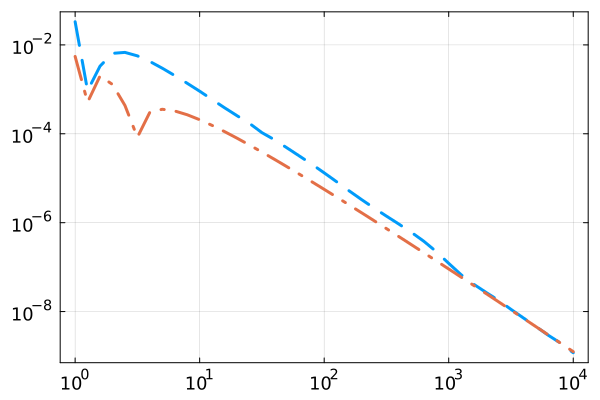

In [28]:
plot(uList, abs.(I1s0data), xscale=:log10, yscale=:log10)
#plot!(uList[2:length(uList)], map(x -> 1.3e-2/x^2*log(x), uList[2:length(uList)]))
plot!(uList, I1RDList)

In [203]:
kGW = 1e5;
us = 1e4;
f1s0(x) = (4/9*aint(x/kGW)/aint(xf/kGW)*g1int(kGW,x) * (2*Phiint(us*kGW,us*x)^2 + 4/3/(1+EoSwint(x/kGW))*(Phiint(us*kGW,us*x)+Piint(us*kGW,us*x)*us*kGW/calHint(x/kGW))^2));
f1s0RD(x) = (4/9*x/xf*cos(x) * (2*PhiRD1(us*x)^2 + (PhiRD1(us*x) + PhipRD1(us*x)*us*x)^2));

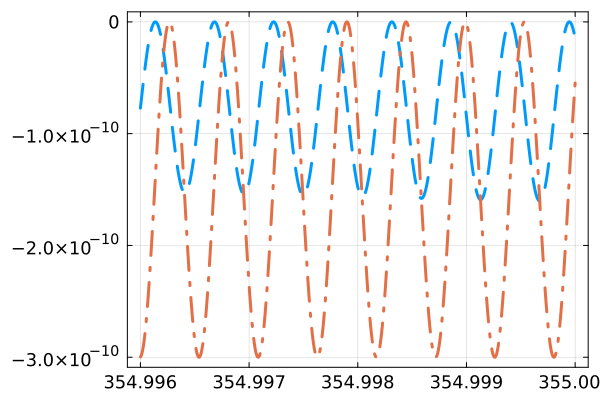

In [227]:
xList = [x for x=(355-(4e-3)):1e-6:355];
plot(xList, map(x -> x*f1s0(x), xList))
plot!(xList, map(x -> x*f1s0RD(x), xList))

In [235]:
@time (quadgk(f1s0,xi/us,xf), quadgk(f1s0RD,xi/us,xf))

 65.968247 seconds (1.50 G allocations: 67.597 GiB, 8.14% gc time, 0.37% compilation time)


((2.264193427402846e-9, 1.569790153703079e-12), (1.252812419262523e-9, 2.1189850038513972e-13))

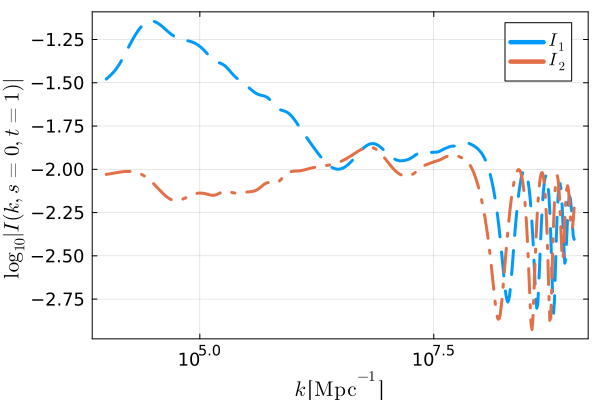

In [40]:
plot(kList, [log10(abs(I1(kList[i],0,1))) for i=1:length(kList)], xscale=:log10, 
    xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|I(k,s=0,t=1)|$", label=L"$I_1$", legend=true)
plot!(kList, [log10(abs(I2(kList[i],0,1))) for i=1:length(kList)], label=L"$I_2$")

In [38]:
@time I11e4 = I1List(1e4);
@time I21e4 = I2List(1e4);

 99.985494 seconds (1.48 G allocations: 96.028 GiB, 4.63% gc time, 1.58% compilation time)
 65.268748 seconds (968.61 M allocations: 62.368 GiB, 4.68% gc time, 2.46% compilation time)


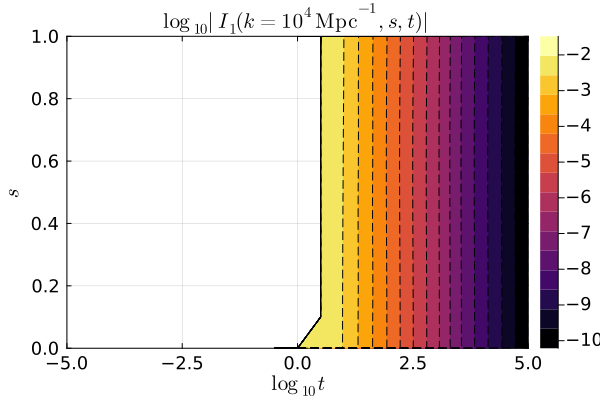

In [43]:
contourf(lntspan,sspan,log10.(abs.(I11e4)), title=L"$\log_{10}|I_1(k=10^4\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", ylabel=L"$s$", legend=true, linewidth=:1)

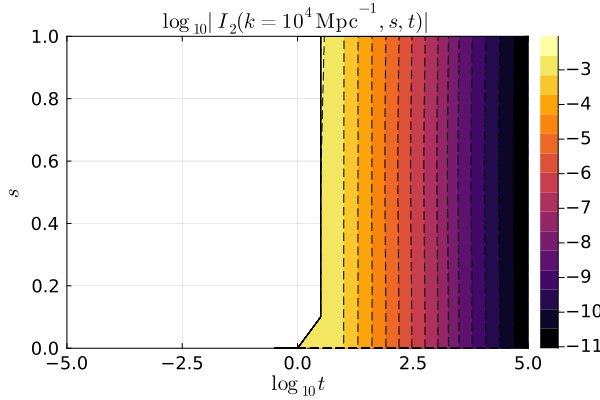

In [45]:
contourf(lntspan,sspan,log10.(abs.(I21e4)), title=L"$\log_{10}|I_2(k=10^4\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", ylabel=L"$s$", legend=true, linewidth=:1)

In [85]:
tmin = 1e-5;
tmax = 1e5;

σ2 = 0.01;
ks = 1e8;
calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log10(k/ks))^2/2/σ2);

I11e4CSI = CubicSplineInterpolation((sspan, lntspan), I11e4)
I11e4int(s,t) = I11e4CSI(s,log10(t))
    
I21e4CSI = CubicSplineInterpolation((sspan, lntspan), I21e4)
I21e4int(s,t) = I21e4CSI(s,log10(t))
    
I2bar1e4int(s,t) = (I11e4int(s,t)^2 * g2g2int(1e4) - 2*I11e4int(s,t)*I21e4int(s,t)*g1g2int(1e4) 
    + I21e4int(s,t)^2 * g1g1int(1e4))
    
calPh1e4int(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2bar1e4int(s,t) * calPz((t+s+1)/2*1e4) 
    * calPz((t-s+1)/2*1e4))
    
4*coeffint(1e4) * dblquad(calPh1e4int,tmin,tmax,0,1)[1]

6.13939339620122e-10

In [63]:
@time begin
    open(string("data/Is/I1_1.dat"),"w") do out
        Base.print_array(out, I11e4)
    end

    open(string("data/Is/I2_1.dat"),"w") do out
        Base.print_array(out, I21e4)
    end
end

  1.105109 seconds (10.39 M allocations: 634.258 MiB, 44.73% compilation time)


In [26]:
@time for i=71:10:91
    #if i%10 == 1
    #    continue
    #else
        open(string("data/Is/I1_", i, ".dat"),"w") do out
            Base.print_array(out, I1List(kList[i]))
        end

        open(string("data/Is/I2_", i, ".dat"),"w") do out
            Base.print_array(out, I2List(kList[i]))
        end
    #end
end;

4188.381439 seconds (632.95 G allocations: 9.285 TiB, 18.62% gc time, 0.02% compilation time)


## load

In [29]:
tmin = 1e-5;
tmax = 1e5;
lntspan = log10(tmin):0.01:log10(tmax);
sspan = 0:0.01:1;

I1table = [zeros(length(sspan),length(lntspan)) for i=1:501];
I2table = [zeros(length(sspan),length(lntspan)) for i=1:501];


for i=1:50:501#:10:391
    f = open(string("data/Is/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

for i=311:10:391#:10:391
    f = open(string("data/Is/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

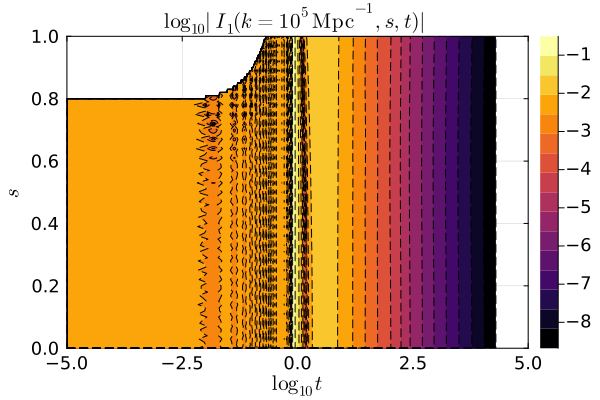

In [33]:
contourf(lntspan,sspan,log10.(abs.(I1table[101])), 
    title=L"$\log_{10}|I_1(k=10^5\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", 
    ylabel=L"$s$", legend=true, linewidth=:1)

In [37]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [41]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [45]:
@time begin
    f = open("data/hk.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hList = reduce(hcat,numarray);


    f = open("data/hkp.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hpList = reduce(hcat,numarray);
end;

  8.579385 seconds (1.43 M allocations: 3.646 GiB, 10.60% gc time, 0.83% compilation time)


In [47]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

hCSI = CubicSplineInterpolation((lnkspan, xspan), hList);
hint(k,x) = hCSI(log10(k),x);

hpCSI = CubicSplineInterpolation((lnkspan, xspan), hpList);
hpint(k,x) = hpCSI(log10(k),x);

In [48]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [49]:
hRD(x) = sin(x)/x;
h2intRD(x) = hRD(x)*hRD(x);
h2barRD = quadgk(h2intRD,xf-dx,xf)[1]/dx

3.23370052209608e-6

In [50]:
kmin = 1e4;
kmax = 1e9;

calPz(k) = 1;

#=
σ2 = 1e-2; #0.25;
ks = 1e8;
kcut = 5e8;
ns = 3;
calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log(k/ks))^2/2/σ2);
=#

#=
function calPz(k)
    if k<ks
        return (k/ks)^(ns-1)
    else
        return 0
    end
end;
=#

function OGW(i)
    I1CSI = CubicSplineInterpolation((sspan, lntspan), I1table[i])
    I1int(s,t) = I1CSI(s,log10(t))
    
    I2CSI = CubicSplineInterpolation((sspan, lntspan), I2table[i])
    I2int(s,t) = I2CSI(s,log10(t))
    
    I2barint(s,t) = (I1int(s,t)^2 * g2g2int(kList[i]) - 2*I1int(s,t)*I2int(s,t)*g1g2int(kList[i]) 
        + I2int(s,t)^2 * g1g1int(kList[i]))
    
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barint(s,t) * calPz((t+s+1)/2*kList[i])
        * calPz((t-s+1)/2*kList[i]))
    
    return 4*coeffint(kList[i]) * dblquad(calPhint,tmin,#min(tmax,2*kcut/kList[i])
        tmax,0,1)[1]
end;

function OGWList(iGWList)
    OGWList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWList[i] = OGW(iGWList[i])
    end
    return OGWList
end;

In [51]:
function I2RD(s,t) 
    xf = 400
    I2RD = (-(t-s+1)*(t+s+1)+1/2*(-5+s^2+t*(2+t))*log(abs((-2+t*(2+t))/(3-s^2))))^2
    if t > sqrt(3)-1
        I2RD += π^2/4*(-5+s^2+t*(2+t))^2
    end
    return 288*(-5+s^2+t*(2+t))^2/(1-s+t)^6/(1+s+t)^6 * I2RD /xf^2
end;
    
function OGWRD(k)
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*k) * calPz((t-s+1)/2*k))
    return 4*coeffint(k) * dblquad(calPhint,tmin,#min(tmax,2*kcut/k)
        tmax,0,1)[1] * h2bar(k)/h2barRD
    #return dblquad(calPhint,tmin,min(tmax,2*kmax/k),0,1)[1]/6
end;

function OGWRDList(iGWList)
    OGWRDList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWRDList[i] = OGWRD(kList[iGWList[i]])
    end
    return OGWRDList
end;

In [54]:
iIR = 101;
kIR = kList[iIR];

I1IRCSI = CubicSplineInterpolation((sspan, lntspan), I1table[iIR]);
I1IRint(s,t) = I1IRCSI(s,log10(t));
    
I2IRCSI = CubicSplineInterpolation((sspan, lntspan), I2table[iIR]);
I2IRint(s,t) = I2IRCSI(s,log10(t));
    
I2barIRint(s,t) = (I1IRint(s,t)^2 * g2g2int(kIR) - 2*I1IRint(s,t)*I2IRint(s,t)*g1g2int(kIR) 
        + I2IRint(s,t)^2 * g1g1int(kIR));
    
calPhIRint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barIRint(s,t) * calPz((t+s+1)/2*kIR)
        * calPz((t-s+1)/2*kIR));

calPhIRRDint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*kIR) * calPz((t-s+1)/2*kIR)) * h2bar(kIR)/h2barRD;

In [73]:
@time OGW(391)

  7.548683 seconds (179.66 M allocations: 2.986 GiB, 1.44% gc time, 11.96% compilation time)


0.30240358490683633

In [93]:
#kGWList = vcat([kList[i] for i=101:10:191], [kList[i] for i=201:300], [kList[i] for i=301:10:391]);
#@time OGWList = vcat([OGW(i) for i=101:10:191], [OGW(i) for i=201:300], [OGW(i) for i=301:10:391]);

iGWList = vcat([i for i=101:50:301], [i for i=311:10:401]);#:10:391];
kGWList = [kList[iGWList[i]] for i=1:length(iGWList)];
@time OGWdata = OGWList(iGWList);

 44.572708 seconds (3.49 G allocations: 55.145 GiB, 11.32% gc time, 0.26% compilation time)


In [68]:
@time OGWRD(kList[391])

  0.006755 seconds (1.26 k allocations: 172.453 KiB)


0.36403653172512423

In [101]:
#kRDList = [10^lnk for lnk=5:0.01:8];
#@time OGWRDList = [OGWRD(kGWList[i]) for i=1:length(kGWList)];
@time OGWRDdata = OGWRDList(iGWList);

  0.500542 seconds (1.64 M allocations: 101.903 MiB, 933.84% compilation time)


In [105]:
OGWdata[1]/OGWRDdata[1]

0.976544375633354

In [74]:
OGWRDIR(k) = 3*(k/ks)^2*exp(σ2)*(log(k/ks)+σ2)^2*erf(k/ks*exp(σ2)/2/sqrt(σ2));

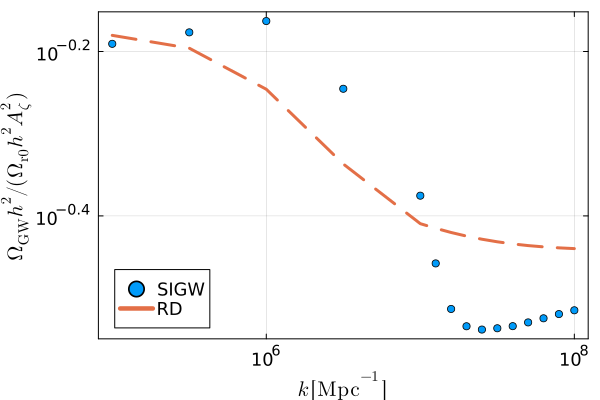

In [125]:
plot(kGWList#*MpcinvinHz/2/π*1e9
    , OGWdata, xlabel=#L"$f\,[\mathrm{nHz}]$"
    L"k\,[\mathrm{Mpc}^{-1}]", ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", 
    seriestype=:scatter, label="SIGW", legend=:bottomleft, 
    xscale=:log10, yscale=:log10)
plot!(kGWList#*MpcinvinHz/2/π*1e9, #[18*Olinint(kRDList[i]) for i=1:length(kRDList)]
    , OGWRDdata, linestyle=:dash, label=#"linear"
"RD")
#plot!(kGWList, [10^2.1*(kGWList[i]/ks)^3 for i=1:length(kGWList)], linestyle=:dot, label=L"$k^3$")
#plot!(kGWList, [OGWRDIR(kGWList[i]) for i=1:length(kGWList)], label="IR limit")

In [33]:
savefig("OGW_1e8_01_wRD.pdf")

"/Users/yuichirotada/Documents/Univ/SIGW_QCD/math/OGW_1e8_01_wRD.pdf"

## Is400 scale inv

In [21]:
tmin = 1e-5;
tmax = 1e5;
lntspan = log10(tmin):0.01:log10(tmax);
sspan = 0:0.01:1;

I1table = [zeros(length(sspan),length(lntspan)) for i=1:501];
I2table = [zeros(length(sspan),length(lntspan)) for i=1:501];


for i=101:10:391
    f = open(string("data/Is400/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is400/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

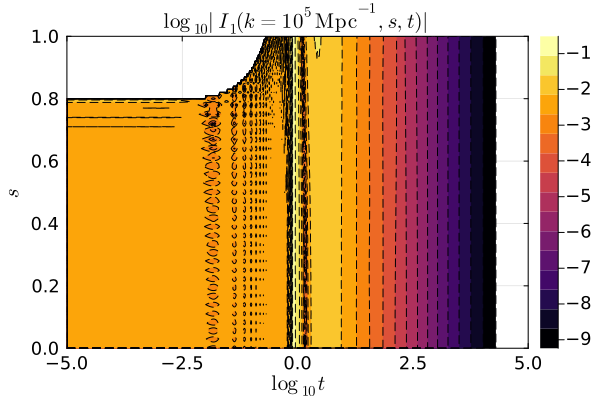

In [23]:
contourf(lntspan,sspan,log10.(abs.(I1table[101])), 
    title=L"$\log_{10}|I_1(k=10^5\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", 
    ylabel=L"$s$", legend=true, linewidth=:1)

In [25]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [27]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [29]:
@time begin
    f = open("data/hk.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hList = reduce(hcat,numarray);


    f = open("data/hkp.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hpList = reduce(hcat,numarray);
end;

 18.135083 seconds (1.43 M allocations: 3.627 GiB, 21.38% gc time, 0.67% compilation time)


In [30]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

hCSI = CubicSplineInterpolation((lnkspan, xspan), hList);
hint(k,x) = hCSI(log10(k),x);

hpCSI = CubicSplineInterpolation((lnkspan, xspan), hpList);
hpint(k,x) = hpCSI(log10(k),x);

In [31]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [32]:
hRD(x) = sin(x)/x;
h2intRD(x) = hRD(x)*hRD(x);
h2barRD = quadgk(h2intRD,xf-dx,xf)[1]/dx

3.23370052209608e-6

In [33]:
kmin = 1e4;
kmax = 1e9;

calPz(k) = 1;

#=
σ2 = 1e-2; #0.25;
ks = 1e8;
kcut = 5e8;
ns = 3;
calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log(k/ks))^2/2/σ2);
=#

#=
function calPz(k)
    if k<ks
        return (k/ks)^(ns-1)
    else
        return 0
    end
end;
=#

function OGW(i)
    I1CSI = CubicSplineInterpolation((sspan, lntspan), I1table[i])
    I1int(s,t) = I1CSI(s,log10(t))
    
    I2CSI = CubicSplineInterpolation((sspan, lntspan), I2table[i])
    I2int(s,t) = I2CSI(s,log10(t))
    
    I2barint(s,t) = (I1int(s,t)^2 * g2g2int(kList[i]) - 2*I1int(s,t)*I2int(s,t)*g1g2int(kList[i]) 
        + I2int(s,t)^2 * g1g1int(kList[i]))
    
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barint(s,t) * calPz((t+s+1)/2*kList[i])
        * calPz((t-s+1)/2*kList[i]))
    
    return 4*coeffint(kList[i]) * dblquad(calPhint,tmin,#min(tmax,2*kcut/kList[i])
        tmax,0,1)[1]
end;

function OGWList(iGWList)
    OGWList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWList[i] = OGW(iGWList[i])
    end
    return OGWList
end;

In [34]:
function I2RD(s,t) 
    xf = 400
    I2RD = (-(t-s+1)*(t+s+1)+1/2*(-5+s^2+t*(2+t))*log(abs((-2+t*(2+t))/(3-s^2))))^2
    if t > sqrt(3)-1
        I2RD += π^2/4*(-5+s^2+t*(2+t))^2
    end
    return 288*(-5+s^2+t*(2+t))^2/(1-s+t)^6/(1+s+t)^6 * I2RD /xf^2
end;
    
function OGWRD(k)
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*k) * calPz((t-s+1)/2*k))
    return 4*coeffint(k) * dblquad(calPhint,tmin,#min(tmax,2*kcut/k)
        tmax,0,1)[1] * h2bar(k)/h2barRD
    #return dblquad(calPhint,tmin,min(tmax,2*kmax/k),0,1)[1]/6
end;

function OGWRDList(iGWList)
    OGWRDList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWRDList[i] = OGWRD(kList[iGWList[i]])
    end
    return OGWRDList
end;

In [36]:
iIR = 101;
kIR = kList[iIR];

I1IRCSI = CubicSplineInterpolation((sspan, lntspan), I1table[iIR]);
I1IRint(s,t) = I1IRCSI(s,log10(t));
    
I2IRCSI = CubicSplineInterpolation((sspan, lntspan), I2table[iIR]);
I2IRint(s,t) = I2IRCSI(s,log10(t));
    
I2barIRint(s,t) = (I1IRint(s,t)^2 * g2g2int(kIR) - 2*I1IRint(s,t)*I2IRint(s,t)*g1g2int(kIR) 
        + I2IRint(s,t)^2 * g1g1int(kIR));
    
calPhIRint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barIRint(s,t) * calPz((t+s+1)/2*kIR)
        * calPz((t-s+1)/2*kIR));

calPhIRRDint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*kIR) * calPz((t-s+1)/2*kIR)) * h2bar(kIR)/h2barRD;

In [43]:
@time OGW(391)

  8.996689 seconds (184.82 M allocations: 3.069 GiB, 1.57% gc time, 16.28% compilation time)


0.3022507202068496

In [45]:
#kGWList = vcat([kList[i] for i=101:10:191], [kList[i] for i=201:300], [kList[i] for i=301:10:391]);
#@time OGWList = vcat([OGW(i) for i=101:10:191], [OGW(i) for i=201:300], [OGW(i) for i=301:10:391]);

iGWList = [i for i=101:10:391];
kGWList = [kList[iGWList[i]] for i=1:length(iGWList)];
@time OGWdata = OGWList(iGWList);

 86.678955 seconds (6.11 G allocations: 96.568 GiB, 14.66% gc time, 0.21% compilation time)


In [46]:
@time OGWRD(kList[391])

  0.575298 seconds (1.12 M allocations: 70.690 MiB, 3.25% gc time, 98.62% compilation time)


0.36403653172512423

In [47]:
#kRDList = [10^lnk for lnk=5:0.01:8];
#@time OGWRDList = [OGWRD(kGWList[i]) for i=1:length(kGWList)];
@time OGWRDdata = OGWRDList(iGWList);

  0.186126 seconds (245.84 k allocations: 18.376 MiB, 186.49% compilation time)


In [48]:
OGWdata[1]/OGWRDdata[1]

0.9761163715417904

In [49]:
OGWRDIR(k) = 3*(k/ks)^2*exp(σ2)*(log(k/ks)+σ2)^2*erf(k/ks*exp(σ2)/2/sqrt(σ2));

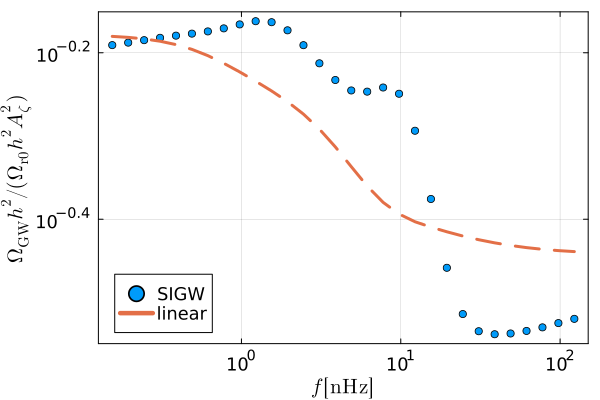

In [57]:
plot(kGWList*MpcinvinHz/2/π*1e9, OGWdata, xlabel=L"$f\,[\mathrm{nHz}]$", ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", 
    seriestype=:scatter, label="SIGW", legend=:bottomleft, 
    xscale=:log10, yscale=:log10)
plot!(kGWList*MpcinvinHz/2/π*1e9, OGWRDdata, linestyle=:dash, label="linear")
#plot!(kGWList, [10^2.1*(kGWList[i]/ks)^3 for i=1:length(kGWList)], linestyle=:dot, label=L"$k^3$")
#plot!(kGWList, [OGWRDIR(kGWList[i]) for i=1:length(kGWList)], label="IR limit")

In [59]:
savefig("OGW400_scaleinv.pdf")

"/Users/yuichiro/Documents/Univ/SIGW_QCD/math/OGW400_scaleinv.pdf"

## Is400 broken power law

In [7]:
tmin = 1e-5;
tmax = 1e5;
lntspan = log10(tmin):0.01:log10(tmax);
sspan = 0:0.01:1;

I1table = [zeros(length(sspan),length(lntspan)) for i=1:501];
I2table = [zeros(length(sspan),length(lntspan)) for i=1:501];


for i=101:10:391
    f = open(string("data/Is400/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is400/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

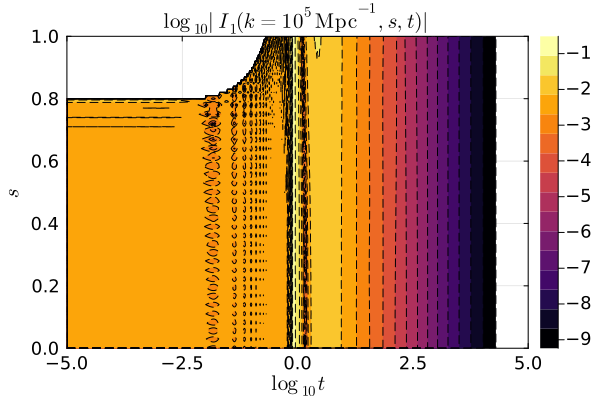

In [9]:
contourf(lntspan,sspan,log10.(abs.(I1table[101])), 
    title=L"$\log_{10}|I_1(k=10^5\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", 
    ylabel=L"$s$", legend=true, linewidth=:1)

In [10]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [11]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [13]:
@time begin
    f = open("data/hk.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hList = reduce(hcat,numarray);


    f = open("data/hkp.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hpList = reduce(hcat,numarray);
end;

 15.125414 seconds (1.43 M allocations: 3.627 GiB, 6.13% gc time, 0.71% compilation time)


In [16]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

hCSI = CubicSplineInterpolation((lnkspan, xspan), hList);
hint(k,x) = hCSI(log10(k),x);

hpCSI = CubicSplineInterpolation((lnkspan, xspan), hpList);
hpint(k,x) = hpCSI(log10(k),x);

In [17]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [18]:
hRD(x) = sin(x)/x;
h2intRD(x) = hRD(x)*hRD(x);
h2barRD = quadgk(h2intRD,xf-dx,xf)[1]/dx

3.23370052209608e-6

In [37]:
kmin = 1e4;
kmax = 1e9;

#calPz(k) = 1;

#=
σ2 = 1e-2; #0.25;
ks = 1e8;
kcut = 5e8;
ns = 3;
calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log(k/ks))^2/2/σ2);
=#

ks = 10/(MpcinvinHz/2/π*1e9);
function calPz(k)
    if k<ks
        return (k/ks)^(0.5)
    else
        return (k/ks)^(-0.5)
    end
end;


function OGW(i)
    I1CSI = CubicSplineInterpolation((sspan, lntspan), I1table[i])
    I1int(s,t) = I1CSI(s,log10(t))
    
    I2CSI = CubicSplineInterpolation((sspan, lntspan), I2table[i])
    I2int(s,t) = I2CSI(s,log10(t))
    
    I2barint(s,t) = (I1int(s,t)^2 * g2g2int(kList[i]) - 2*I1int(s,t)*I2int(s,t)*g1g2int(kList[i]) 
        + I2int(s,t)^2 * g1g1int(kList[i]))
    
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barint(s,t) * calPz((t+s+1)/2*kList[i])
        * calPz((t-s+1)/2*kList[i]))
    
    return 4*coeffint(kList[i]) * dblquad(calPhint,tmin,#min(tmax,2*kcut/kList[i])
        tmax,0,1)[1]
end;

function OGWList(iGWList)
    OGWList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWList[i] = OGW(iGWList[i])
    end
    return OGWList
end;

In [39]:
function I2RD(s,t) 
    xf = 400
    I2RD = (-(t-s+1)*(t+s+1)+1/2*(-5+s^2+t*(2+t))*log(abs((-2+t*(2+t))/(3-s^2))))^2
    if t > sqrt(3)-1
        I2RD += π^2/4*(-5+s^2+t*(2+t))^2
    end
    return 288*(-5+s^2+t*(2+t))^2/(1-s+t)^6/(1+s+t)^6 * I2RD /xf^2
end;
    
function OGWRD(k)
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*k) * calPz((t-s+1)/2*k))
    return 4*coeffint(k) * dblquad(calPhint,tmin,#min(tmax,2*kcut/k)
        tmax,0,1)[1] * h2bar(k)/h2barRD
    #return dblquad(calPhint,tmin,min(tmax,2*kmax/k),0,1)[1]/6
end;

function OGWRDList(iGWList)
    OGWRDList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWRDList[i] = OGWRD(kList[iGWList[i]])
    end
    return OGWRDList
end;

In [41]:
iIR = 101;
kIR = kList[iIR];

I1IRCSI = CubicSplineInterpolation((sspan, lntspan), I1table[iIR]);
I1IRint(s,t) = I1IRCSI(s,log10(t));
    
I2IRCSI = CubicSplineInterpolation((sspan, lntspan), I2table[iIR]);
I2IRint(s,t) = I2IRCSI(s,log10(t));
    
I2barIRint(s,t) = (I1IRint(s,t)^2 * g2g2int(kIR) - 2*I1IRint(s,t)*I2IRint(s,t)*g1g2int(kIR) 
        + I2IRint(s,t)^2 * g1g1int(kIR));
    
calPhIRint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barIRint(s,t) * calPz((t+s+1)/2*kIR)
        * calPz((t-s+1)/2*kIR));

calPhIRRDint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*kIR) * calPz((t-s+1)/2*kIR)) * h2bar(kIR)/h2barRD;

In [43]:
@time OGW(391)

 10.182592 seconds (230.92 M allocations: 3.628 GiB, 2.02% gc time, 4.84% compilation time)


0.022359729319610826

In [44]:
#kGWList = vcat([kList[i] for i=101:10:191], [kList[i] for i=201:300], [kList[i] for i=301:10:391]);
#@time OGWList = vcat([OGW(i) for i=101:10:191], [OGW(i) for i=201:300], [OGW(i) for i=301:10:391]);

iGWList = [i for i=101:10:391];
kGWList = [kList[iGWList[i]] for i=1:length(iGWList)];
@time OGWdata = OGWList(iGWList);

171.936960 seconds (9.24 G allocations: 144.342 GiB, 5.50% gc time, 0.05% compilation time)


In [46]:
@time OGWRD(kList[391])

  0.575298 seconds (1.12 M allocations: 70.690 MiB, 3.25% gc time, 98.62% compilation time)


0.36403653172512423

In [47]:
#kRDList = [10^lnk for lnk=5:0.01:8];
#@time OGWRDList = [OGWRD(kGWList[i]) for i=1:length(kGWList)];
@time OGWRDdata = OGWRDList(iGWList);

  0.186126 seconds (245.84 k allocations: 18.376 MiB, 186.49% compilation time)


In [48]:
OGWdata[1]/OGWRDdata[1]

0.9761163715417904

In [49]:
OGWRDIR(k) = 3*(k/ks)^2*exp(σ2)*(log(k/ks)+σ2)^2*erf(k/ks*exp(σ2)/2/sqrt(σ2));

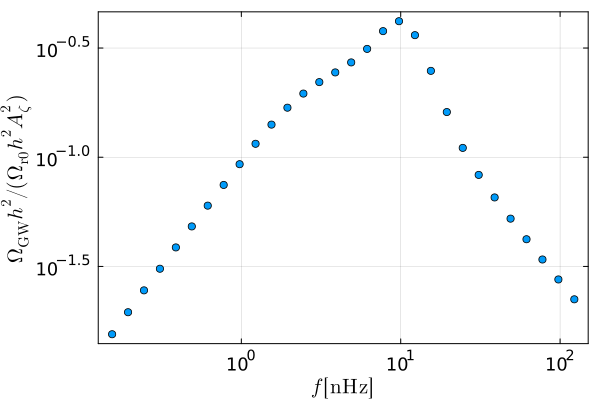

In [46]:
plot(kGWList*MpcinvinHz/2/π*1e9, OGWdata, xlabel=L"$f\,[\mathrm{nHz}]$", ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", 
    seriestype=:scatter, label="SIGW", #legend=:bottomleft, 
    xscale=:log10, yscale=:log10)
#plot!(kGWList*MpcinvinHz/2/π*1e9, OGWRDdata, linestyle=:dash, label="linear")
#plot!(kGWList, [10^2.1*(kGWList[i]/ks)^3 for i=1:length(kGWList)], linestyle=:dot, label=L"$k^3$")
#plot!(kGWList, [OGWRDIR(kGWList[i]) for i=1:length(kGWList)], label="IR limit")

In [49]:
savefig("OGW400_brokenpower.pdf")

"/Users/yuichiro/Documents/Univ/SIGW_QCD/math/OGW400_brokenpower.pdf"

## Is400 lognormal

In [8]:
tmin = 1e-5;
tmax = 1e5;
lntspan = log10(tmin):0.01:log10(tmax);
sspan = 0:0.01:1;

I1table = [zeros(length(sspan),length(lntspan)) for i=1:501];
I2table = [zeros(length(sspan),length(lntspan)) for i=1:501];


for i=101:10:391
    f = open(string("data/Is400/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is400/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

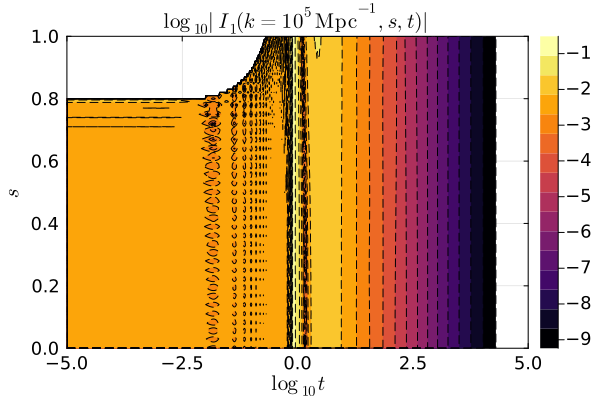

In [9]:
contourf(lntspan,sspan,log10.(abs.(I1table[101])), 
    title=L"$\log_{10}|I_1(k=10^5\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", 
    ylabel=L"$s$", legend=true, linewidth=:1)

In [10]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [11]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [12]:
@time begin
    f = open("data/hk.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hList = reduce(hcat,numarray);


    f = open("data/hkp.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    hpList = reduce(hcat,numarray);
end;

 15.442016 seconds (1.43 M allocations: 3.627 GiB, 6.91% gc time, 0.79% compilation time)


In [14]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

hCSI = CubicSplineInterpolation((lnkspan, xspan), hList);
hint(k,x) = hCSI(log10(k),x);

hpCSI = CubicSplineInterpolation((lnkspan, xspan), hpList);
hpint(k,x) = hpCSI(log10(k),x);

In [15]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [16]:
hRD(x) = sin(x)/x;
h2intRD(x) = hRD(x)*hRD(x);
h2barRD = quadgk(h2intRD,xf-dx,xf)[1]/dx

3.23370052209608e-6

In [24]:
kmin = 1e4;
kmax = 1e9;

#calPz(k) = 1;

σ2 = 1
ks = 10/(MpcinvinHz/2/π*1e9);
calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log(k/ks))^2/2/σ2);

#=
ks = 10/(MpcinvinHz/2/π*1e9);
function calPz(k)
    if k<ks
        return (k/ks)^(0.5)
    else
        return (k/ks)^(-0.5)
    end
end;
=#


function OGW(i)
    I1CSI = CubicSplineInterpolation((sspan, lntspan), I1table[i])
    I1int(s,t) = I1CSI(s,log10(t))
    
    I2CSI = CubicSplineInterpolation((sspan, lntspan), I2table[i])
    I2int(s,t) = I2CSI(s,log10(t))
    
    I2barint(s,t) = (I1int(s,t)^2 * g2g2int(kList[i]) - 2*I1int(s,t)*I2int(s,t)*g1g2int(kList[i]) 
        + I2int(s,t)^2 * g1g1int(kList[i]))
    
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barint(s,t) * calPz((t+s+1)/2*kList[i])
        * calPz((t-s+1)/2*kList[i]))
    
    return 4*coeffint(kList[i]) * dblquad(calPhint,tmin,#min(tmax,2*kcut/kList[i])
        tmax,0,1)[1]
end;

function OGWList(iGWList)
    OGWList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWList[i] = OGW(iGWList[i])
    end
    return OGWList
end;

In [26]:
function I2RD(s,t) 
    xf = 400
    I2RD = (-(t-s+1)*(t+s+1)+1/2*(-5+s^2+t*(2+t))*log(abs((-2+t*(2+t))/(3-s^2))))^2
    if t > sqrt(3)-1
        I2RD += π^2/4*(-5+s^2+t*(2+t))^2
    end
    return 288*(-5+s^2+t*(2+t))^2/(1-s+t)^6/(1+s+t)^6 * I2RD /xf^2
end;
    
function OGWRD(k)
    calPhint(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*k) * calPz((t-s+1)/2*k))
    return 4*coeffint(k) * dblquad(calPhint,tmin,#min(tmax,2*kcut/k)
        tmax,0,1)[1] * h2bar(k)/h2barRD
    #return dblquad(calPhint,tmin,min(tmax,2*kmax/k),0,1)[1]/6
end;

function OGWRDList(iGWList)
    OGWRDList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWRDList[i] = OGWRD(kList[iGWList[i]])
    end
    return OGWRDList
end;

In [28]:
iIR = 101;
kIR = kList[iIR];

I1IRCSI = CubicSplineInterpolation((sspan, lntspan), I1table[iIR]);
I1IRint(s,t) = I1IRCSI(s,log10(t));
    
I2IRCSI = CubicSplineInterpolation((sspan, lntspan), I2table[iIR]);
I2IRint(s,t) = I2IRCSI(s,log10(t));
    
I2barIRint(s,t) = (I1IRint(s,t)^2 * g2g2int(kIR) - 2*I1IRint(s,t)*I2IRint(s,t)*g1g2int(kIR) 
        + I2IRint(s,t)^2 * g1g1int(kIR));
    
calPhIRint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barIRint(s,t) * calPz((t+s+1)/2*kIR)
        * calPz((t-s+1)/2*kIR));

calPhIRRDint(s,t) = 4*coeffint(kIR)*((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2RD(s,t) * calPz((t+s+1)/2*kIR) * calPz((t-s+1)/2*kIR)) * h2bar(kIR)/h2barRD;

In [30]:
@time OGW(391)

 13.068471 seconds (308.26 M allocations: 4.906 GiB, 1.07% gc time, 10.97% compilation time)


0.00011468176312043735

In [31]:
#kGWList = vcat([kList[i] for i=101:10:191], [kList[i] for i=201:300], [kList[i] for i=301:10:391]);
#@time OGWList = vcat([OGW(i) for i=101:10:191], [OGW(i) for i=201:300], [OGW(i) for i=301:10:391]);

iGWList = [i for i=101:10:391];
kGWList = [kList[iGWList[i]] for i=1:length(iGWList)];
@time OGWdata = OGWList(iGWList);

141.331973 seconds (8.12 G allocations: 125.326 GiB, 5.97% gc time, 0.07% compilation time)


In [46]:
@time OGWRD(kList[391])

  0.575298 seconds (1.12 M allocations: 70.690 MiB, 3.25% gc time, 98.62% compilation time)


0.36403653172512423

In [47]:
#kRDList = [10^lnk for lnk=5:0.01:8];
#@time OGWRDList = [OGWRD(kGWList[i]) for i=1:length(kGWList)];
@time OGWRDdata = OGWRDList(iGWList);

  0.186126 seconds (245.84 k allocations: 18.376 MiB, 186.49% compilation time)


In [48]:
OGWdata[1]/OGWRDdata[1]

0.9761163715417904

In [49]:
OGWRDIR(k) = 3*(k/ks)^2*exp(σ2)*(log(k/ks)+σ2)^2*erf(k/ks*exp(σ2)/2/sqrt(σ2));

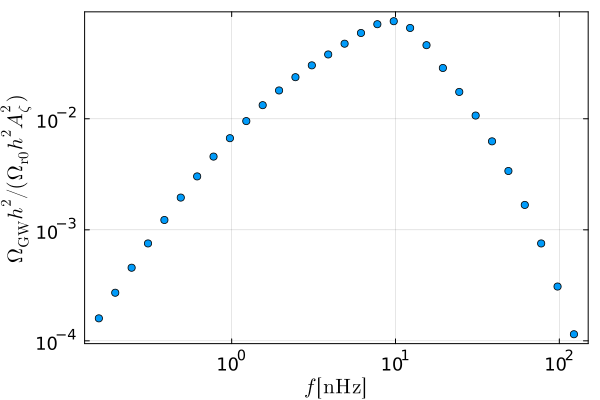

In [32]:
plot(kGWList*MpcinvinHz/2/π*1e9, OGWdata, xlabel=L"$f\,[\mathrm{nHz}]$", ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", 
    seriestype=:scatter, label="SIGW", #legend=:bottomleft, 
    xscale=:log10, yscale=:log10)
#plot!(kGWList*MpcinvinHz/2/π*1e9, OGWRDdata, linestyle=:dash, label="linear")
#plot!(kGWList, [10^2.1*(kGWList[i]/ks)^3 for i=1:length(kGWList)], linestyle=:dot, label=L"$k^3$")
#plot!(kGWList, [OGWRDIR(kGWList[i]) for i=1:length(kGWList)], label="IR limit")

In [36]:
savefig("OGW400_lognormal.pdf")

"/Users/yuichiro/Documents/Univ/SIGW_QCD/math/OGW400_lognormal.pdf"

## monochromatic

In [17]:
tmin = 1e-5;
tmax = 1e5;
lntspan = log10(tmin):0.01:log10(tmax);
sspan = 0:0.01:1;

I1table = [zeros(length(sspan),length(lntspan)) for i=1:501];
I2table = [zeros(length(sspan),length(lntspan)) for i=1:501];

I1table[1] = readdlm("data/IsHubble/I1_1.csv", ',');
I2table[1] = readdlm("data/IsHubble/I2_1.csv", ',');

for i=101:50:501
    I1table[i] = readdlm(string("data/IsHubble/I1_", i, ".csv"), ',');
    I2table[i] = readdlm(string("data/IsHubble/I2_", i, ".csv"), ',');
end;

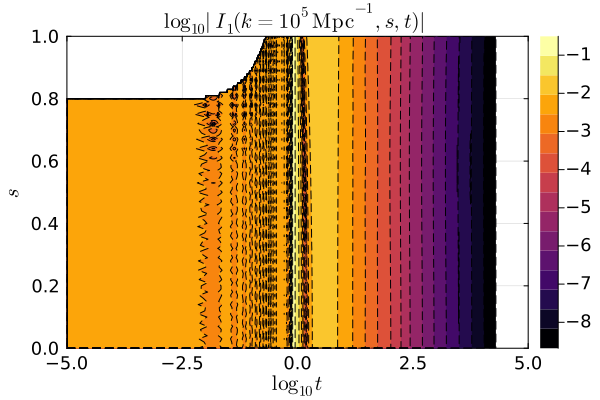

In [19]:
contourf(lntspan,sspan,log10.(abs.(I1table[101])), 
    title=L"$\log_{10}|I_1(k=10^5\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", 
    ylabel=L"$s$", legend=true, linewidth=1)

In [21]:
coeffdata = readdlm("data/g1g2coeff.csv", ',');

lnkList = coeffdata[:,1];
g1g1List = coeffdata[:,2];
g1g2List = coeffdata[:,3];
g2g2List = coeffdata[:,4];
coeffList = coeffdata[:,5];
OlinList = coeffdata[:,6];

In [27]:
kList = [10^lnk for lnk in lnkList];

g1g1CSI = Spline1D(lnkList, g1g1List, k=3);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = Spline1D(lnkList, g1g2List, k=3);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = Spline1D(lnkList, g2g2List, k=3);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = Spline1D(lnkList, coeffList, k=3);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = Spline1D(lnkList, OlinList, k=3);
Olinint(k) = OlinCSI(log10(k));

In [37]:
hkdata = readdlm("data/hk.csv",',');
xList = hkdata[1,:];
hkList = hkdata[2:1+length(kList),:];
hpList = hkdata[2+length(kList):size(hkdata)[1],:];

xi = xList[1];
xf = xList[length(xList)];

hkCSI = Spline2D(lnkList,xList,hkList,kx=3,ky=3);
hpCSI = Spline2D(lnkList,xList,hpList,kx=3,ky=3);

hint(k,x) = hkCSI(log10(k),x);
hpint(k,x) = hpCSI(log10(k),x);

In [41]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [43]:
hRD(x) = sin(x)/x;
h2intRD(x) = hRD(x)*hRD(x);
h2barRD = quadgk(h2intRD,xf-dx,xf)[1]/dx

3.23370052209608e-6

In [45]:
kmin = kList[1];
kmax = kList[length(kList)];

ks = 3e8;

function OGW(i)
    if kList[i] > 2*ks
        return 0
    else
        I1CSI = CubicSplineInterpolation((sspan, lntspan), I1table[i])
        I1int(s,t) = I1CSI(s,log10(t))

        I2CSI = CubicSplineInterpolation((sspan, lntspan), I2table[i])
        I2int(s,t) = I2CSI(s,log10(t))

        I2barint(s,t) = (I1int(s,t)^2 * g2g2int(kList[i]) - 2*I1int(s,t)*I2int(s,t)*g1g2int(kList[i]) 
            + I2int(s,t)^2 * g1g1int(kList[i]))

        u = ks/kList[i]
        t = 2*u-1
        s = 0

        return 4*coeffint(kList[i]) * ((4*u^2-1)/4/u)^2 * I2barint(s,t)
    end
end;

function OGWList(iGWList)
    OGWList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWList[i] = OGW(iGWList[i])
    end
    return OGWList
end;

In [47]:
function I2RD(s,t) 
    xf = 400
    I2RD = (-(t-s+1)*(t+s+1)+1/2*(-5+s^2+t*(2+t))*log(abs((-2+t*(2+t))/(3-s^2))))^2
    if t > sqrt(3)-1
        I2RD += π^2/4*(-5+s^2+t*(2+t))^2
    end
    return 288*(-5+s^2+t*(2+t))^2/(1-s+t)^6/(1+s+t)^6 * I2RD /xf^2
end;
    
function OGWRD(k)
    if k > 2*k
        return 0
    else
        u = ks/k
        t = 2*u-1
        s = 0

        return 4*coeffint(k) * ((4*u^2-1)/4/u)^2 * I2RD(s,t)
    end
end;

function OGWRDList(iGWList)
    OGWRDList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWRDList[i] = OGWRD(kList[iGWList[i]])
    end
    return OGWRDList
end;

In [49]:
#kGWList = vcat([kList[i] for i=101:10:191], [kList[i] for i=201:300], [kList[i] for i=301:10:391]);
#@time OGWList = vcat([OGW(i) for i=101:10:191], [OGW(i) for i=201:300], [OGW(i) for i=301:10:391]);

iGWList = vcat([1], [i for i=101:50:401]);#:10:391];
kGWList = [kList[iGWList[i]] for i=1:length(iGWList)];
@time OGWdata = OGWList(iGWList);

  1.774326 seconds (3.39 M allocations: 248.738 MiB, 808.69% compilation time)


In [53]:
iRDList = [i for i=1:401];
kRDList = [kList[iRDList[i]] for i=1:length(iRDList)];
#@time OGWRDList = [OGWRD(kGWList[i]) for i=1:length(kGWList)];
@time OGWRDdata = OGWRDList(iRDList);

  0.095924 seconds (153.24 k allocations: 9.191 MiB, 644.22% compilation time)


In [55]:
OGWdata[1]/OGWRDdata[1]

0.4434940667109342

In [57]:
function OGWRDanal(kt)
    if kt > 2
        return 0
    else
        OGWRDanal = (4+(3*kt^2-2)*log(abs(1-4/3/kt^2)))^2
        if 3*kt < 2*sqrt(3)
            OGWRDanal += π^2*(3*kt^2-2)^2
        end
        
        OGWRDanal *= 3/64*((4-kt^2)/4)^2*kt^2*(3*kt^2-2)^2
        
        return OGWRDanal
    end
end;

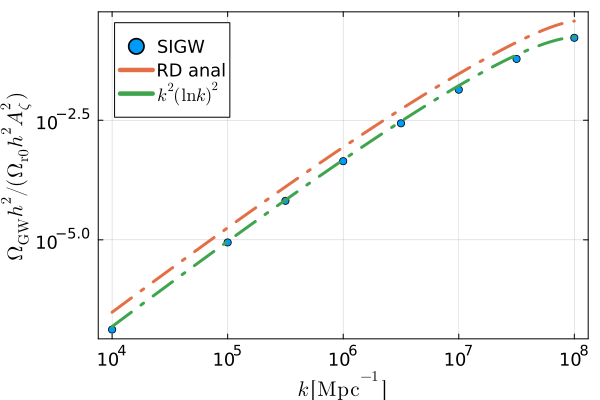

In [59]:
plot(kGWList#*MpcinvinHz/2/π*1e9
    , OGWdata, xlabel=#L"$f\,[\mathrm{nHz}]$"
    L"k\,[\mathrm{Mpc}^{-1}]", ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", 
    seriestype=:scatter, 
    legend=:topleft, label="SIGW", 
    xscale=:log10, yscale=:log10)
#plot!(kRDList#*MpcinvinHz/2/π*1e9, #[18*Olinint(kRDList[i]) for i=1:length(kRDList)]
#    , OGWRDdata, linestyle=:dash, label=#"linear"
#"RD")
plot!(kRDList, [OGWRDanal(kRDList[i]/ks) for i=1:length(kRDList)], label="RD anal")
#plot!(kGWList, [10^1.6*(kGWList[i]/ks)^2 for i=1:length(kGWList)], linestyle=:dot, label=L"$k^2$", xlim=(5e3,2e8))
plot!(kRDList, [1.3*(kRDList[i]/ks)^2*log(kRDList[i]/ks)^2 for i=1:length(kRDList)], linestyle=:dashdot, label=L"$k^2(\ln k)^2$")
#plot!(kGWList, [OGWRDIR(kGWList[i]) for i=1:length(kGWList)], label="IR limit")

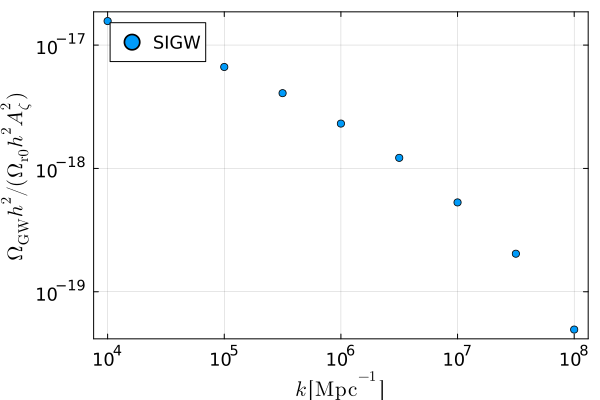

In [61]:
plot(kGWList, [OGWdata[i]/kGWList[i]^2/log(kGWList[i])^2 for i=1:length(OGWdata)], xlabel=L"k\,[\mathrm{Mpc}^{-1}]", 
    ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", seriestype=:scatter, 
    legend=:topleft, label="SIGW", 
    xscale=:log10, yscale=:log10)

In [81]:
savefig("OGW_1e8_delta.pdf")

"/Users/yuichirotada/Documents/Univ/SIGW_QCD/math/OGW_1e8_delta.pdf"

# xiGW = 1e-7

In [4]:
f = open("data/bg.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnetaList = [numarray[i][1] for i=1:length(numarray)];
anormList = [numarray[i][2] for i=1:length(numarray)];
calHList = [numarray[i][3] for i=1:length(numarray)];
EoSwList = [numarray[i][4] for i=1:length(numarray)];
cs2List = [numarray[i][5] for i=1:length(numarray)];
grhoList = [numarray[i][6] for i=1:length(numarray)];
gsList = [numarray[i][7] for i=1:length(numarray)];

In [5]:
lnetaspan = range(lnetaList[1], lnetaList[length(lnetaList)], length=length(lnetaList))
etai = 10^lnetaList[1];
etaf = 10^lnetaList[length(lnetaList)];

aCSI = CubicSplineInterpolation(lnetaspan, anormList);
aint(eta) = aCSI(log10(eta));

calHCSI = CubicSplineInterpolation(lnetaspan, calHList);
function calHint(eta) 
    if eta < etai
        return 1/eta
    else
        return calHCSI(log10(eta))
    end
end;

EoSwCSI = CubicSplineInterpolation(lnetaspan, EoSwList);
function EoSwint(eta) 
    if eta < etai
        return 1/3
    else
        return EoSwCSI(log10(eta))
    end
end;

cs2CSI = CubicSplineInterpolation(lnetaspan, cs2List);
function cs2int(eta) 
    if eta < etai
        return 1/3
    else
        return cs2CSI(log10(eta))
    end
end;

grhoCSI = CubicSplineInterpolation(lnetaspan, grhoList);
grhoint(eta) = grhoCSI(log10(eta));

gsCSI = CubicSplineInterpolation(lnetaspan, gsList);
gsint(eta) = gsCSI(log10(eta));

In [6]:
k = 1e5;

xiGW = 1e-7;
xf = 400;
xList = [10^lnx for lnx=log10(xiGW):0.01:log10(xf)];

In [7]:
function gkEoM(du,u,p,x) # u[1] = g, u[2] = dgdx, p[1] = k
    du[1] = u[2]
    du[2] = - (1 - (1-3*EoSwint(x/p[1]))/2*calHint(x/p[1])^2/p[1]^2)*u[1]
end;

xspan = (xiGW, xf);

function gk1e5(ui)
    p = [1e5]
    tensorprob = ODEProblem(gkEoM,ui,xspan,p)
    tensorsol = solve(tensorprob,Tsit5(),reltol=1e-10,abstol=1e-10)
    gsol(x) = tensorsol(x)[1]
    gpsol(x) = tensorsol(x)[2]
    return [gsol,gpsol]
end;

In [8]:
g1RD(x) = cos(x);
g1pRD(x) = -sin(x);
g2RD(x) = sin(x);
g2pRD(x) = cos(x);

In [9]:
ui1 = [g1RD(xiGW),g1pRD(xiGW)];
ui2 = [g2RD(xiGW),g2pRD(xiGW)];

@time g11e5, g1p1e5 = gk1e5(ui1);
@time g21e5, g2p1e5 = gk1e5(ui2);

  0.520432 seconds (2.92 M allocations: 122.782 MiB, 4.88% gc time, 88.77% compilation time)
  0.051280 seconds (1.24 M allocations: 25.911 MiB, 18.06% gc time)


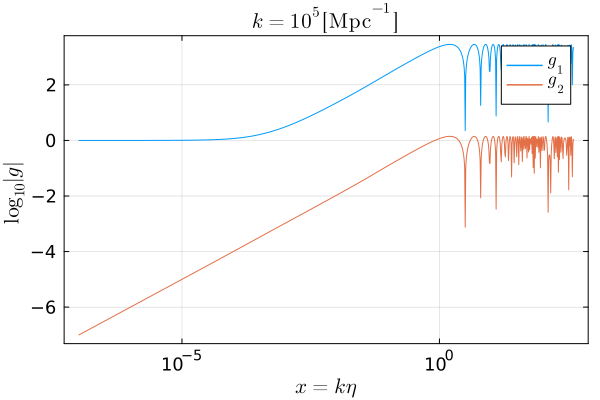

In [10]:
plot(xList, [log10(abs(g11e5(xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(xList, [log10(abs(g21e5(xList[i]))) for i=1:length(xList)], label=L"$g_2$")

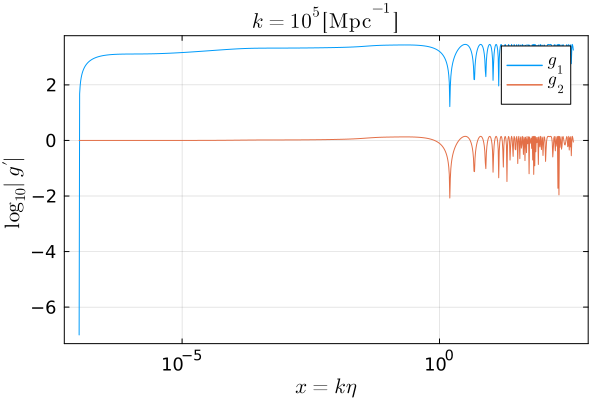

In [11]:
plot(xList, [log10(abs(g1p1e5(xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^5\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    legend=true)
plot!(xList, [log10(abs(g2p1e5(xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

In [12]:
dx = 2*2*π;

function g1g1bar1e5()
    f(x) = g11e5(x)*g11e5(x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g2g2bar1e5()
    f(x) = g21e5(x)*g21e5(x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g1g2bar1e5()
    f(x) = g11e5(x)*g21e5(x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

In [13]:
@time begin
    f = open("data/Phi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PhiList = reduce(hcat,numarray);

    f = open("data/Pi.dat","r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    PiList = reduce(hcat,numarray);
end;

  8.358915 seconds (1.46 M allocations: 3.629 GiB, 5.78% gc time, 0.96% compilation time)


In [14]:
PhiRD(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD
PhipRD(x) = 3*(9*x*cos(x/sqrt(3)) + sqrt(3)*(x^2-9)*sin(x/sqrt(3)))/x^4;
PhiRDf(x,Phif,Pif) = ((9*Phif*xf + 3*Pif*xf*(-x + xf) + Phif*x*(-9 + xf^2))*cos((x - xf)/sqrt(3)) 
    + sqrt(3)*(Pif*xf*(3 + x*xf) + Phif*(9 + 3*x*xf - xf^2))*sin((x - xf)/sqrt(3))) / x^3;
PhipRDf(x,Phif,Pif) = (3*(Pif*xf*(9*x - 9*xf + x^2*xf) 
        + 3*Phif*(-9*xf + x^2*xf - x*(-9 + xf^2)))*cos((x - xf)/sqrt(3)) 
    - sqrt(3)*(3*Pif*xf*(9 - x^2 + 3*x*xf) 
        + Phif*(27*x*xf - 9*(-9 + xf^2) + x^2*(-9 + xf^2)))*sin((x - xf)/sqrt(3))) / 3/x^4;

In [15]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

PhiCSI = CubicSplineInterpolation((lnkspan, xspan), PhiList);
function Phiint(k,x)
    if x < xi
        return PhiRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf)) 
    else
        return PhiCSI(log10(k),x)
    end;
end;

PiCSI = CubicSplineInterpolation((lnkspan, xspan), PiList);
function Piint(k,x) 
    if x < xi
        return PhipRD(x)
    elseif x > xf
        return PhiRDf(x,PhiCSI(log10(k),xf),PiCSI(log10(k),xf))
    else
        return PiCSI(log10(k),x)
    end
end;

In [16]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [17]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [22]:
function I11e5(s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (xf < x1 || xf < x2)
                return 0
            else
                return (4/9*aint(eta)/aint(xf/k)*g11e5(x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))
                    *(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
            end
        end
        x1f = k/k1*xf
        x2f = k/k2*xf
        return -quadgk(f,xiGW,min(xf,x1f,x2f))[1]
    end
end;

function I21e5(s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (xf < x1 || xf < x2)
                return 0
            else
                return (4/9*aint(eta)/aint(xf/k)*g21e5(x) * (2*Phiint(k1,x1)*Phiint(k2,x2) 
                    + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))
                    *(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta))))
            end
        end
        x1f = k/k1*xf
        x2f = k/k2*xf
        return -quadgk(f,xiGW,min(xf,x1f,x2f))[1]
    end
end;

lntspan = -5.:0.01:5;
sspan = 0:0.01:1;
tList = [10^lnt for lnt=lntspan];
sList = [s for s=sspan];

function I11e5List()
    I1List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I1List[i,j] = I11e5(sList[i],tList[j])
        end
    end
    return I1List
end;

function I21e5List()
    I2List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I2List[i,j] = I21e5(sList[i],tList[j])
        end
    end
    return I2List
end;

In [23]:
@time I11e5data = I11e5List();
@time I21e5data = I21e5List();

816.906808 seconds (134.49 G allocations: 2.064 TiB, 23.17% gc time, 0.32% compilation time)
927.238699 seconds (136.91 G allocations: 2.102 TiB, 21.52% gc time, 0.24% compilation time)


In [29]:
open(string("data/I1_1e5_xi=1e-7.dat"),"w") do out
    Base.print_array(out, I11e5data)
end

open(string("data/I2_1e5_xi=1e-7.dat"),"w") do out
    Base.print_array(out, I21e5data)
end

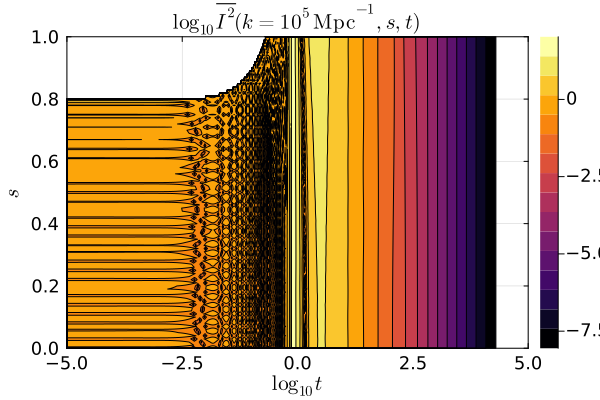

In [25]:
contourf(lntspan,sspan,log10.(abs.(I11e5data)), title=L"$\log_{10}\overline{I^2}(k=10^5\,\mathrm{Mpc}^{-1},s,t)$", xlabel=L"$\log_{10}t$", ylabel=L"$s$", legend=true)

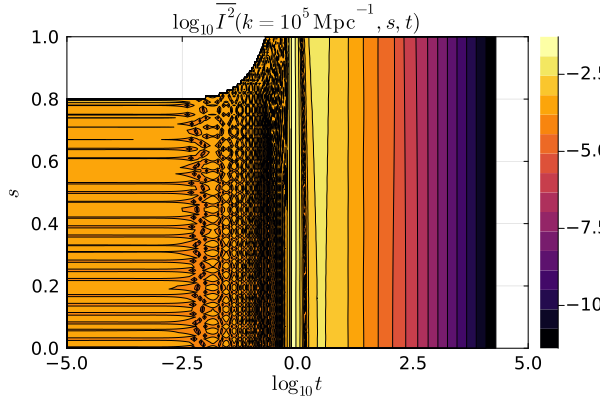

In [26]:
contourf(lntspan,sspan,log10.(abs.(I21e5data)), title=L"$\log_{10}\overline{I^2}(k=10^5\,\mathrm{Mpc}^{-1},s,t)$", xlabel=L"$\log_{10}t$", ylabel=L"$s$", legend=true)

In [28]:
tmin = 1e-5;
tmax = 1e5;

σ2 = 0.25;
ks = 5e8;
ns = 3;
#calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log(k/ks))^2/2/σ2);
function calPz(k)
    if k<ks
        return (k/ks)^(ns-1)
    else
        return 0
    end
end;

I11e5CSI = CubicSplineInterpolation((sspan, lntspan), I11e5data)
I11e5int(s,t) = I11e5CSI(s,log10(t))
    
I21e5CSI = CubicSplineInterpolation((sspan, lntspan), I21e5data)
I21e5int(s,t) = I21e5CSI(s,log10(t))
    
I2bar1e5int(s,t) = (I11e5int(s,t)^2 * g2g2bar1e5() - 2*I11e5int(s,t)*I21e5int(s,t)*g1g2bar1e5() 
    + I21e5int(s,t)^2 * g1g1bar1e5())
    
calPh1e5int(s,t) = ((t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2bar1e5int(s,t) * calPz((t+s+1)/2*1e5) 
    * calPz((t-s+1)/2*1e5));
    
4*coeffint(1e5) * dblquad(calPh1e5int,tmin,tmax,0,1;method=:divonne)[1]

4.325223108114423e-10